In [1]:
import os
import numpy as np
import pandas as pd
import scanpy as sc
import anndata 
import seaborn as sns
from scipy.stats import zscore
from scipy import sparse 
import itertools

import matplotlib.pyplot as plt
import collections
from sklearn.cluster import KMeans
from sklearn import metrics

from sklearn.decomposition import PCA
from umap import UMAP

from matplotlib.colors import LinearSegmentedColormap

from scroutines.config_plots import *
from scroutines import powerplots # .config_plots import *
from scroutines import pnmf
from scroutines import basicu


/home/qlyu/mambaforge/envs/bbbroutine/lib/python3.8/site-packages/tqdm/auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
outdir     = "/scr/qlyu/projects/v1/results"
outdir_fig = "/scr/qlyu/projects/v1/figures"

In [3]:
adata_raw = anndata.read("../../data/cheng21_cell_scrna/reorganized/all_IT.h5ad")
adata_raw = adata_raw[adata_raw.obs['cond']=='P28NR']
counts = adata_raw.X
allgenes = adata_raw.var.index.values
adata_raw

View of AnnData object with n_obs × n_vars = 11061 × 53801
    obs: 'Class_broad', 'Doublet', 'Doublet Score', 'batch', 'leiden', 'n_counts', 'n_genes', 'percent_mito', 'sample', 'Type', 'Subclass', 'cond'

In [4]:
conds = adata_raw.obs['cond'].values
types = adata_raw.obs['Type'].values
samps = adata_raw.obs['sample'].values

rename_dict = {
    "L2/3_A": "L2/3_A",
    "L2/3_B": "L2/3_B",
    "L2/3_C": "L2/3_C",
    
    "L2/3_1": "L2/3_A",
    "L2/3_2": "L2/3_B",
    "L2/3_3": "L2/3_C",
    
    "L2/3_AB": "L2/3_A",
    "L2/3_BC": "L2/3_C",
}

def rename(x):
    """
    """
    if x in rename_dict.keys():
        return rename_dict[x]
    else:
        return x
    
adata_raw.obs['easitype'] = adata_raw.obs['Type'].apply(rename)

/tmp/ipykernel_2965372/2186893235.py:26: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata_raw.obs['easitype'] = adata_raw.obs['Type'].apply(rename)


In [5]:
# use those 286 genes
# df = pd.read_csv("../../data/cheng21_cell_scrna/res/candidate_genes_vincent_0503_v2.csv")
df = pd.read_csv("../../data/cheng21_cell_scrna/res/L23-ABC-genes-n288-n286unq-annot.csv")
genes_l23 = df['gene'].values
# genes_sel = adata_raw.var.index.values
# genes_grp = df['P17on'].astype(str).values
# assert len(genes_sel) == len(np.unique(genes_sel))

# Use P28 ordering
f = '../../results/gene_ptime_P28_L23_Mar27.tsv'
gpt = pd.read_csv(f)
gpt = gpt['gene_ptime'].values
gptidx = np.argsort(gpt)

In [6]:
# filter genes
cond = np.ravel((adata_raw.X>0).sum(axis=0)) > 10 # expressed in more than 10 cells
adata_sub = adata_raw[:,cond]

# counts
x = adata_sub.X
cov = adata_sub.obs['n_counts'].values
genes = adata_sub.var.index.values

# CP10k
xn = (sparse.diags(1/cov).dot(x))*1e4

# log10(CP10k+1)
xln = xn.copy()
xln.data = np.log10(xln.data+1)

adata_sub.layers['norm'] = xn
adata_sub.layers['lognorm'] = xln

In [7]:
# select HVGs with mean and var
nbin = 20
qth = 0.3

# min
gm = np.ravel(xn.mean(axis=0))

# var
tmp = xn.copy()
tmp.data = np.power(tmp.data, 2)
gv = np.ravel(tmp.mean(axis=0))-gm**2

# cut 
lbl = pd.qcut(gm, nbin, labels=np.arange(nbin))
gres = pd.DataFrame()
gres['name'] = genes
gres['lbl'] = lbl
gres['mean'] = gm
gres['var'] = gv
gres['ratio']= gv/gm

# select
gres_sel = gres.groupby('lbl')['ratio'].nlargest(int(qth*(len(gm)/nbin))) #.reset_index()
gsel_idx = np.sort(gres_sel.index.get_level_values(1).values)

assert np.all(gsel_idx != -1)

In [8]:
l23_gidx = basicu.get_index_from_array(genes, genes_l23)
assert np.all(l23_gidx != -1)

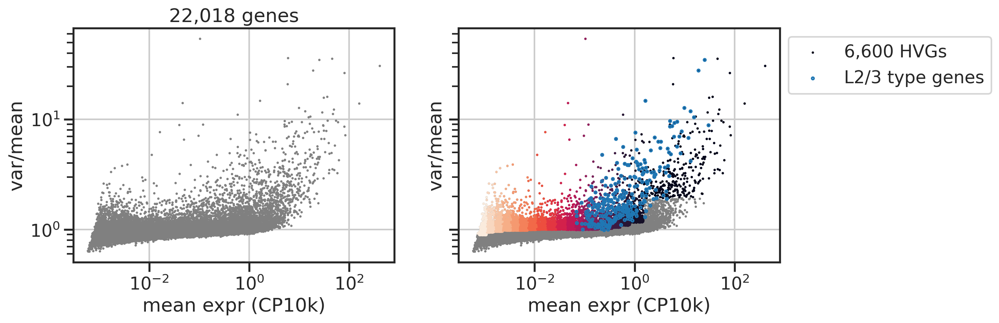

In [9]:
fig, axs = plt.subplots(1,2, figsize=(6*2,4), sharex=True, sharey=True)
ax = axs[0]
ax.scatter(gm, gv/gm, s=5, edgecolor='none', color='gray')
ax.set_xscale('log')
ax.set_yscale('log')
ax.set_xlabel('mean expr (CP10k)')
ax.set_ylabel('var/mean')
ax.set_title(f'{len(gm):,} genes')

ax = axs[1]
ax.scatter(gm, gv/gm, s=5, edgecolor='none', color='gray')
ax.scatter(gm[gsel_idx], (gv/gm)[gsel_idx], c=lbl[gsel_idx], s=5, edgecolor='none', cmap='rocket_r', label=f'{len(gsel_idx):,} HVGs')
ax.scatter(gm[l23_gidx], (gv/gm)[l23_gidx], s=5, facecolors='none', edgecolor='C0', label='L2/3 type genes')
ax.set_xscale('log')
ax.set_yscale('log')
ax.set_xlabel('mean expr (CP10k)')
ax.set_ylabel('var/mean')
ax.legend(bbox_to_anchor=(1,1))

plt.show()

In [10]:
[genes[i] for i in l23_gidx if i not in gsel_idx], np.intersect1d(l23_gidx, gsel_idx).shape, l23_gidx.shape

(['Runx1t1',
  'Foxp1',
  'Focad',
  'Clcn2',
  'Elavl2',
  'Cntn2',
  'Cntnap1',
  'Sel1l3',
  'Osbpl3',
  'Igsf9b',
  'Mkx'],
 (275,),
 (286,))

In [11]:
adata = adata_sub[:,gsel_idx]
genes_sel = adata.var.index.values
lognorm = np.array(adata.layers['lognorm'].todense())
zlognorm = zscore(lognorm, axis=0)
adata

View of AnnData object with n_obs × n_vars = 11061 × 6600
    obs: 'Class_broad', 'Doublet', 'Doublet Score', 'batch', 'leiden', 'n_counts', 'n_genes', 'percent_mito', 'sample', 'Type', 'Subclass', 'cond', 'easitype'
    layers: 'norm', 'lognorm'

In [12]:
%%time
pca = PCA(n_components=50)
pcs = pca.fit_transform(zlognorm)
ucs = UMAP(n_components=2, n_neighbors=50).fit_transform(pcs)

# get results
res = pd.DataFrame(pcs, columns=np.char.add("PC", ((1+np.arange(pcs.shape[1])).astype(str))))
# res['cond'] = conds
res['type'] = types
res['samp'] = samps
res['umap1'] = ucs[:,0]
res['umap2'] = ucs[:,1]

CPU times: user 5min 53s, sys: 33.9 s, total: 6min 27s
Wall time: 27.3 s


Text(0, 0.5, 'explained var')

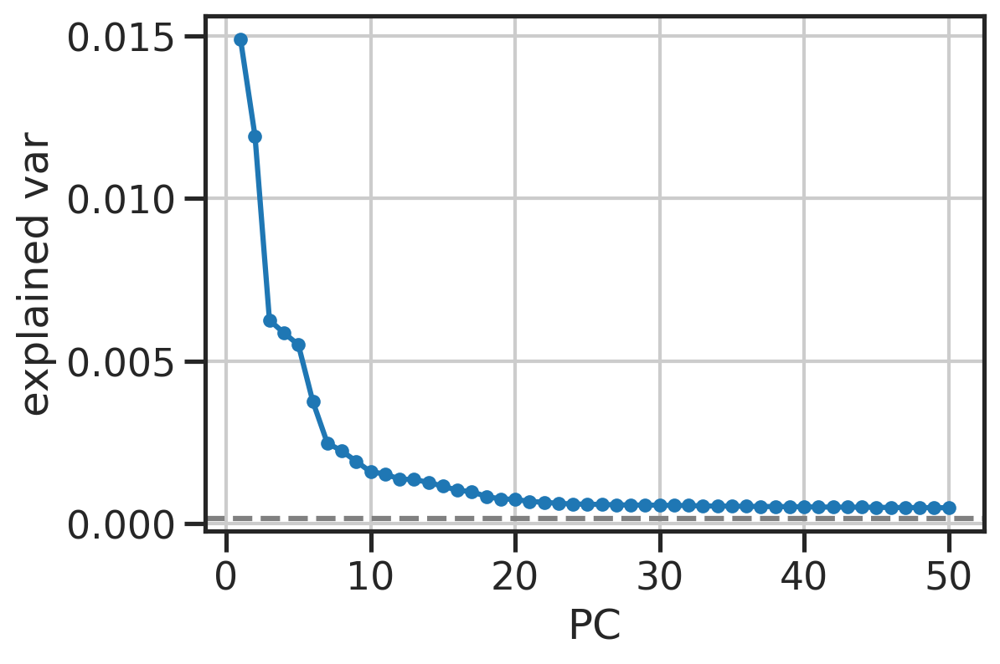

In [13]:
fig, ax = plt.subplots(figsize=(6,4))
ax.plot(np.arange(len(pca.explained_variance_ratio_))+1, pca.explained_variance_ratio_, '-o', markersize=5)
ax.axhline(1/lognorm.shape[1], linestyle='--', color='gray')
ax.set_xlabel('PC')
ax.set_ylabel('explained var')

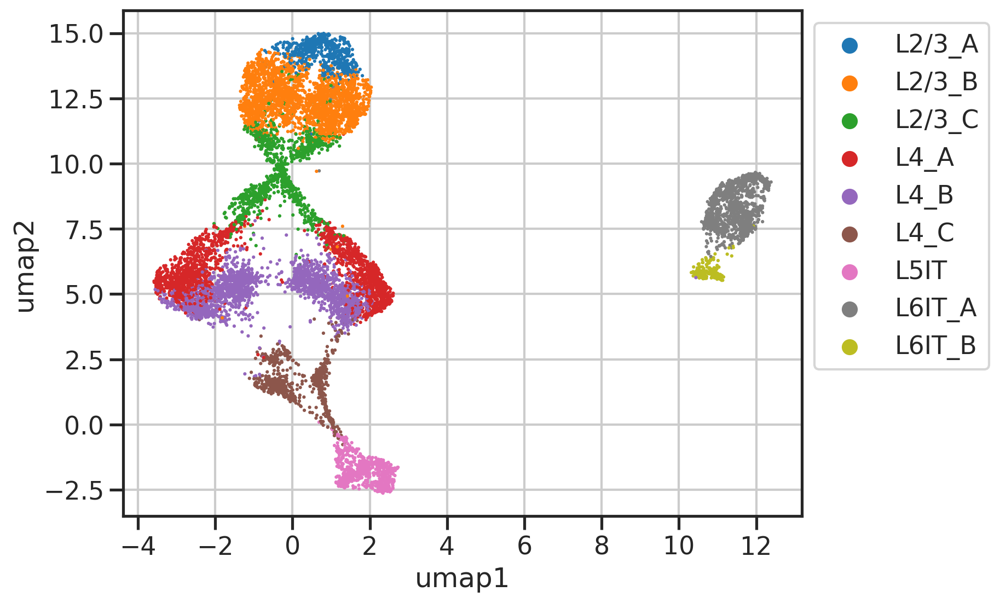

In [14]:
fig, ax = plt.subplots(1,1,figsize=(8*1,6))
sns.scatterplot(data=res.sample(frac=1, replace=False), 
                x='umap1', y='umap2', 
                hue='type',
                # hue='samp',
                # hue_order=list(palette.keys()),
                # palette=palette,
                s=5, edgecolor='none', 
                # legend=False,
                ax=ax,
               )
ax.legend(bbox_to_anchor=(1,1))
plt.show()

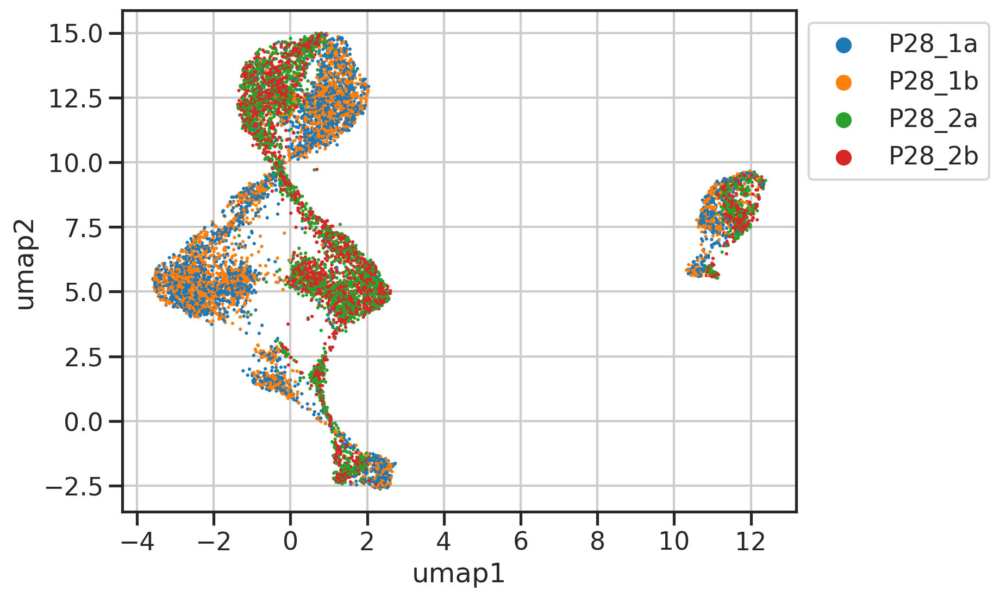

In [15]:
fig, ax = plt.subplots(1,1,figsize=(8*1,6))
sns.scatterplot(data=res.sample(frac=1, replace=False), 
                x='umap1', y='umap2', 
                # hue='type',
                hue='samp',
                # hue_order=list(palette.keys()),
                # palette=palette,
                s=5, edgecolor='none', 
                # legend=False,
                ax=ax,
               )
ax.legend(bbox_to_anchor=(1,1))
plt.show()

In [16]:
def plot_pcs(res, npc, hue):
    fig, axs = plt.subplots(npc-1,npc-1,figsize=(6*(npc-1),5*(npc-1)))
    for i, j in itertools.combinations(range(npc), 2):
        legend = False
        if (i,j) == (0,1): legend=True

        x, y = f"PC{j+1}", f"PC{i+1}"
        ax = axs[i,j-1]

        sns.scatterplot(data=res.sample(frac=1, replace=False), 
                        x=x, y=y, 
                        hue=hue,
                        # hue_order=list(palette.keys()),
                        # palette=palette,
                        s=5, edgecolor='none', 
                        legend=legend,
                        ax=ax,
                       )
        sns.despine(ax=ax)
    axs[0,0].legend(bbox_to_anchor=(0.5, -0.2), loc='upper center')

    for i, j in itertools.product(range(npc-1), range(npc-1)):
        if j<i:
            ax = axs[i,j]
            ax.axis('off')

    plt.show()

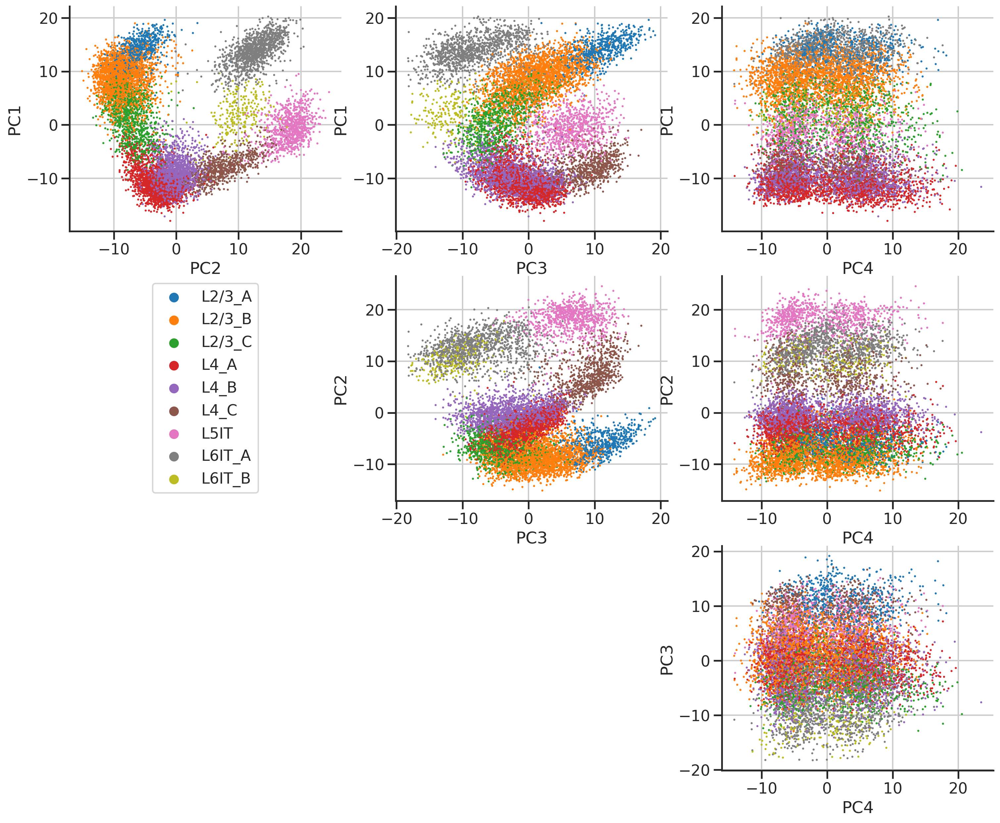

In [17]:
plot_pcs(res, 4, 'type')

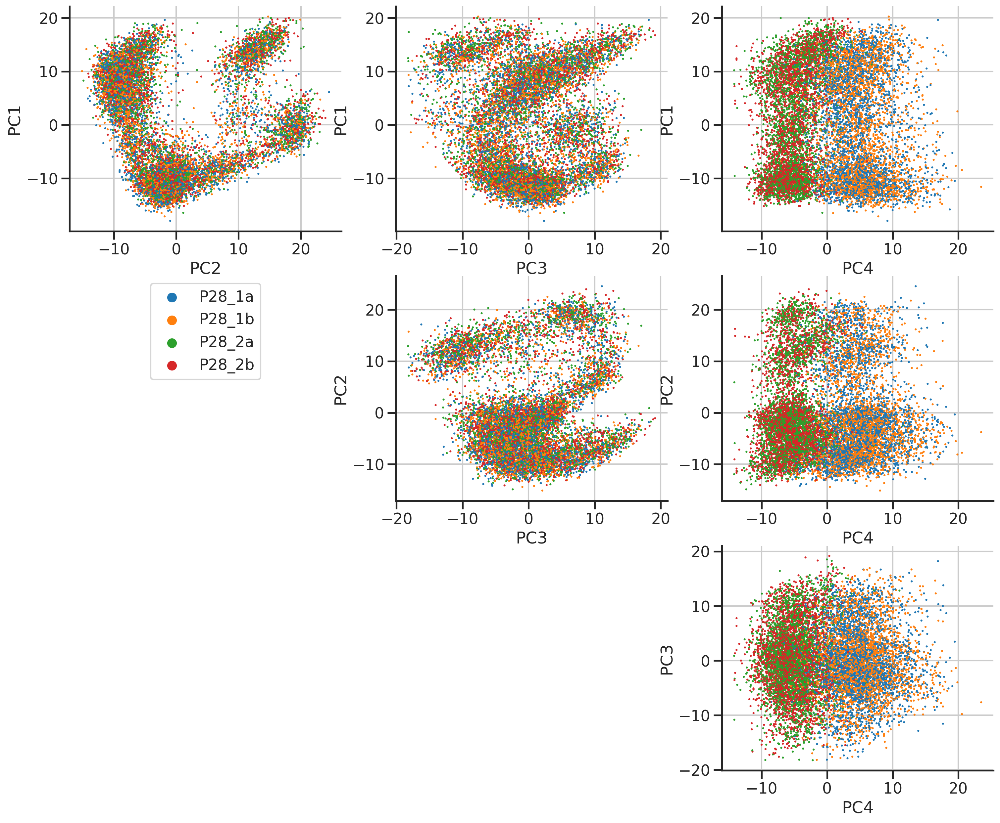

In [18]:
plot_pcs(res, 4, 'samp')

# ptime analysis

In [19]:
adata.obsm['X_pca'] = pcs
sc.pp.neighbors(adata, n_neighbors=50, use_rep='X_pca')
sc.tl.diffmap(adata)
adata.uns['iroot'] = np.argmax(pcs[:,0]+pcs[:,2]) # max PC1+PC4
sc.tl.dpt(adata)

res['ptime'] = adata.obs['dpt_pseudotime'].values
cellidx = np.argsort(res['ptime'].values)

In [20]:
# # # gene ptime
# # weights = ((lognorm+1e-10)/(lognorm.sum(axis=0)+1e-10))
# # gptime  = res['ptime'].values.dot(weights)
# # geneidx = np.argsort(gptime)

# # Use P28 ordering
# f = '../../results/gene_ptime_P28_L23_Mar27.tsv'
# gpt = pd.read_csv(f)
# gpt = gpt['gene_ptime'].values
# geneidx2 = np.argsort(gpt)

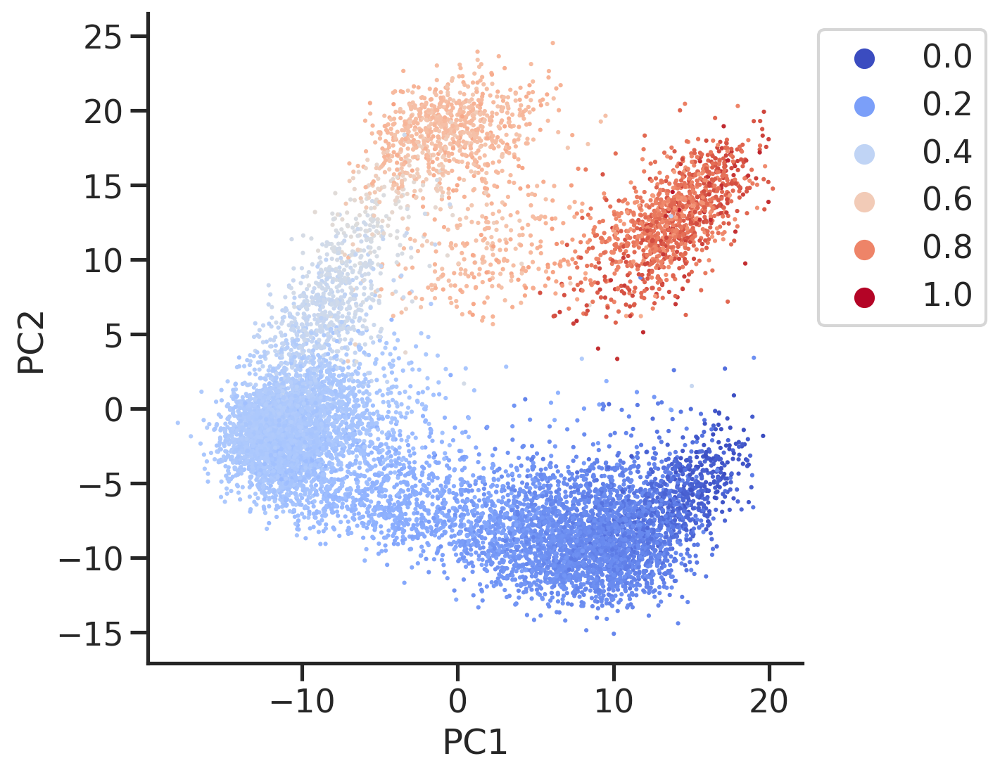

In [21]:
fig, ax = plt.subplots(figsize=(6,6))
sns.scatterplot(data=res, 
                x='PC1',
                y='PC2',
                hue='ptime',
                edgecolor='none',
                s=5,
                ax=ax,
                palette='coolwarm',
               )

ax.legend(bbox_to_anchor=(1,1), loc='upper left')
sns.despine(ax=ax)
ax.grid(False)
plt.show()

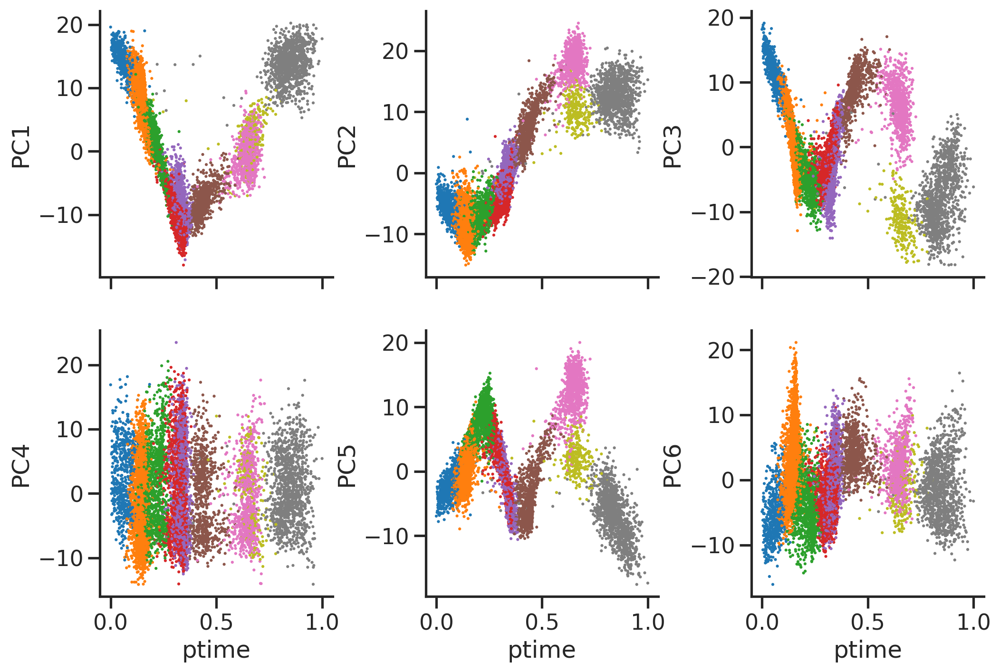

In [22]:
fig, axs = plt.subplots(2, 3, figsize=(4*3,4*2), sharex=True)
for i, ax in enumerate(axs.flat):
    sns.scatterplot(data=res, 
                    x='ptime',
                    y=f'PC{i+1}',
                    hue='type',
                    edgecolor='none',
                    s=5,
                    ax=ax,
                    legend=False,
                   )
    ax.grid(False)
    sns.despine(ax=ax)
fig.subplots_adjust(wspace=0.4)
plt.show()

# check PCs - what genes?
- find some fluctuation genes?

In [23]:
pc_weights = pca.components_
pc_weights.shape

(50, 6600)

In [24]:
pc1_gidx = np.argsort(np.abs( pc_weights[0]))[::-1]
pc1_gidx_up =     np.argsort( pc_weights[0])[::-1]
pc1_gidx_dn =     np.argsort(-pc_weights[0])[::-1]

In [25]:
pc2_gidx = np.argsort(np.abs(pc_weights[1]))[::-1]
pc2_gidx_up = np.argsort(pc_weights[1])[::-1]
pc2_gidx_dn = np.argsort(-pc_weights[1])[::-1]

In [26]:
pc3_gidx = np.argsort(np.abs(pc_weights[2]))[::-1]
pc3_gidx_up = np.argsort(pc_weights[2])[::-1]
pc3_gidx_dn = np.argsort(-pc_weights[2])[::-1]

In [27]:
pc4_gidx = np.argsort(np.abs(pc_weights[3]))[::-1]
pc4_gidx_up = np.argsort(pc_weights[3])[::-1]
pc4_gidx_dn = np.argsort(-pc_weights[3])[::-1]

In [28]:
pc5_gidx = np.argsort(np.abs( pc_weights[4]))[::-1]
pc5_gidx_up =     np.argsort( pc_weights[4])[::-1]
pc5_gidx_dn =     np.argsort(-pc_weights[4])[::-1]

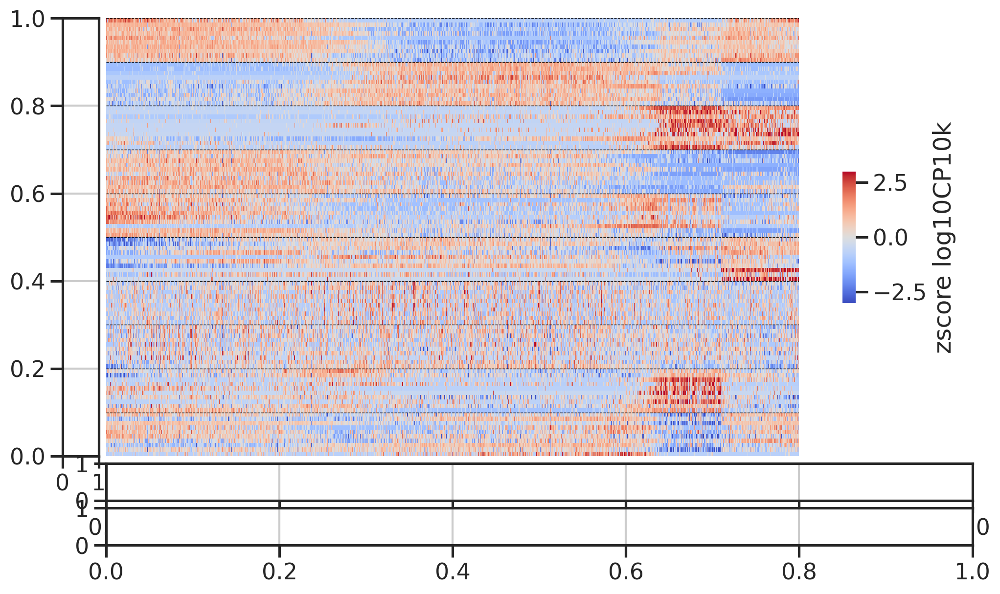

In [29]:
mosaic = ("B"+"A"*20+"\n")*10 + ("."+"C"*20+"\n") + ("."+"D"*20+"\n")

gidx = np.hstack([
    pc1_gidx_up[:10], pc1_gidx_dn[:10], 
    pc2_gidx_up[:10], pc2_gidx_dn[:10], 
    pc3_gidx_up[:10], pc3_gidx_dn[:10], 
    pc4_gidx_up[:10], pc4_gidx_dn[:10], 
    pc5_gidx_up[:10], pc5_gidx_dn[:10], 
])

fig, axdict = plt.subplot_mosaic(mosaic, figsize=(12,7))
ax = axdict['A']
sns.heatmap(zlognorm[cellidx][:,gidx].T,
            xticklabels=False,
            yticklabels=False,
            cbar_kws=dict(shrink=0.3, label='zscore log10CP10k', aspect=10),
            center=0,
            vmax=3,
            vmin=-3,
            cmap='coolwarm',
            rasterized=True,
            ax=ax,
           )
ax.hlines(np.arange(0,50*2,10), 0, len(cellidx), color='k', linestyle='--', linewidth=0.5)

# ax = axdict['B']
# sns.heatmap(pd.factorize(genes_grp[geneidx], sort=True)[0].reshape(-1,1), 
#             xticklabels=False,
#             yticklabels=100,
#             cmap=cmap_d1,
#             cbar=False,
#             rasterized=True,
#             ax=ax, 
#            )
# ax.set_ylabel('Genes')
# ax.set_yticklabels(ax.get_yticklabels(), rotation=0, fontsize=10)
# ax.set_xticklabels(ax.get_xticklabels(), rotation=0, fontsize=10)

# ax = axdict['C']
# sns.heatmap(pd.factorize(types[cellidx], sort=True)[0].reshape(-1,1).T, 
#             xticklabels=False,
#             yticklabels=False,
#             # cmap=cmap_d1,
#             cbar_kws=dict(ticks=[0,1,2], shrink=1.2, aspect=3, label='type'),
#             rasterized=True,
#             ax=ax, 
#            )
# fig.axes[-1].set_yticklabels(['A','B','C'], fontsize=10)
# fig.axes[-1].set_ylabel(fig.axes[-1].get_ylabel(), rotation=0, ha='left')

# ax = axdict['D']
# sns.heatmap(pd.factorize(samps[cellidx], sort=True)[0].reshape(-1,1).T, 
#             xticklabels=1000,
#             yticklabels=False,
#             # cmap=cmap_d2,
#             cbar_kws=dict(ticks=[], shrink=1.2, aspect=3, label='sample'),
#             rasterized=True,
#             ax=ax, 
#            )
# ax.set_xlabel('Cells')
# fig.axes[-1].set_ylabel(fig.axes[-1].get_ylabel(), rotation=0, ha='left')
# ax.set_yticklabels(ax.get_yticklabels(), rotation=0, fontsize=10)
# ax.set_xticklabels(ax.get_xticklabels(), rotation=0, fontsize=10)

# fig.subplots_adjust(hspace=0.5)
# fig.suptitle(sample)
# powerplots.savefig_autodate(fig, os.path.join(outdir_fig, f'heatmap_{sample}_v4.pdf'))
plt.show()

# order genes?
- genes mark ptime?
- genes were reused?

In [30]:
def get_mi(x, ymat, nbins=20):
    """
    """
    # MI for L2/3
    nbins = 20
    xb = pd.cut(x, nbins, labels=np.arange(nbins))

    mi = []
    for i in np.arange(ymat.shape[1]):
        y = ymat[:,i]
        yb = pd.cut(y, nbins, labels=np.arange(nbins))
        _mi = metrics.mutual_info_score(xb, yb)
        mi.append(_mi)
    mi = np.array(mi)
    return mi


In [31]:
num_cells = adata.obs['Subclass'].value_counts().sort_index()
cumsum_cells = np.cumsum(num_cells)
num_cells, cumsum_cells

(L2/3    4044
 L4      4732
 L5IT     849
 L6IT    1436
 Name: Subclass, dtype: int64,
 L2/3     4044
 L4       8776
 L5IT     9625
 L6IT    11061
 Name: Subclass, dtype: int64)

In [32]:
ressort = res.iloc[cellidx]
omat = zlognorm[cellidx]
ocpt = ressort['ptime'].values

In [33]:
%%time
# MI for all
mi = get_mi(ocpt, omat)

# MI for L2/3/4
lcut, rcut = 0, cumsum_cells[1]
mi_l234 = get_mi(ocpt[lcut:rcut], omat[lcut:rcut])

# MI for L4/5
lcut, rcut = cumsum_cells[0], cumsum_cells[2]
mi_l45 = get_mi(ocpt[lcut:rcut], omat[lcut:rcut])

# MI for L5/6
lcut, rcut = cumsum_cells[1], cumsum_cells[3]
mi_l56 = get_mi(ocpt[lcut:rcut], omat[lcut:rcut])

# MI for L2/3
lcut, rcut = 0, cumsum_cells[0]
mi_l23 = get_mi(ocpt[lcut:rcut], omat[lcut:rcut])

# MI for L4
lcut, rcut = cumsum_cells[0], cumsum_cells[1]
mi_l4 = get_mi(ocpt[lcut:rcut], omat[lcut:rcut])

# MI for L5
lcut, rcut = cumsum_cells[1], cumsum_cells[2]
mi_l5 = get_mi(ocpt[lcut:rcut], omat[lcut:rcut])

# MI for L6
lcut, rcut = cumsum_cells[2], cumsum_cells[3]
mi_l6 = get_mi(ocpt[lcut:rcut], omat[lcut:rcut])

CPU times: user 1min 18s, sys: 0 ns, total: 1min 18s
Wall time: 1min 18s


In [34]:
gidx_all = np.argsort(mi)[::-1]
gidx_l23 = np.argsort(mi_l23)[::-1]
gidx_l234 = np.argsort(mi_l234)[::-1]
gidx_l4  = np.argsort(mi_l4)[::-1]
gidx_l56  = np.argsort(mi_l56)[::-1]
gidx_l5  = np.argsort(mi_l5)[::-1]
gidx_l6  = np.argsort(mi_l6)[::-1]

In [35]:
np.sum(mi_l23 > 0.2), np.sum(mi_l4 > 0.2), np.sum(mi_l56 > 0.2)

(48, 30, 176)

In [36]:
allcolors2 = sns.color_palette('tab10', 10)
allcolors2

[(0.12156862745098039, 0.4666666666666667, 0.7058823529411765),
 (1.0, 0.4980392156862745, 0.054901960784313725),
 (0.17254901960784313, 0.6274509803921569, 0.17254901960784313),
 (0.8392156862745098, 0.15294117647058825, 0.1568627450980392),
 (0.5803921568627451, 0.403921568627451, 0.7411764705882353),
 (0.5490196078431373, 0.33725490196078434, 0.29411764705882354),
 (0.8901960784313725, 0.4666666666666667, 0.7607843137254902),
 (0.4980392156862745, 0.4980392156862745, 0.4980392156862745),
 (0.7372549019607844, 0.7411764705882353, 0.13333333333333333),
 (0.09019607843137255, 0.7450980392156863, 0.8117647058823529)]

In [37]:
palette_types = collections.OrderedDict({
    'L2/3_A': allcolors2[0],
    'L2/3_B': allcolors2[1],
    'L2/3_C': allcolors2[2],
    
    'L4_A': allcolors2[3],
    'L4_B': allcolors2[4],
    'L4_C': allcolors2[5],
    
    'L5IT': allcolors2[6],
    
    'L6IT_A': allcolors2[7],
    'L6IT_B': allcolors2[8],
})             

Text(0, 0.5, 'MI')

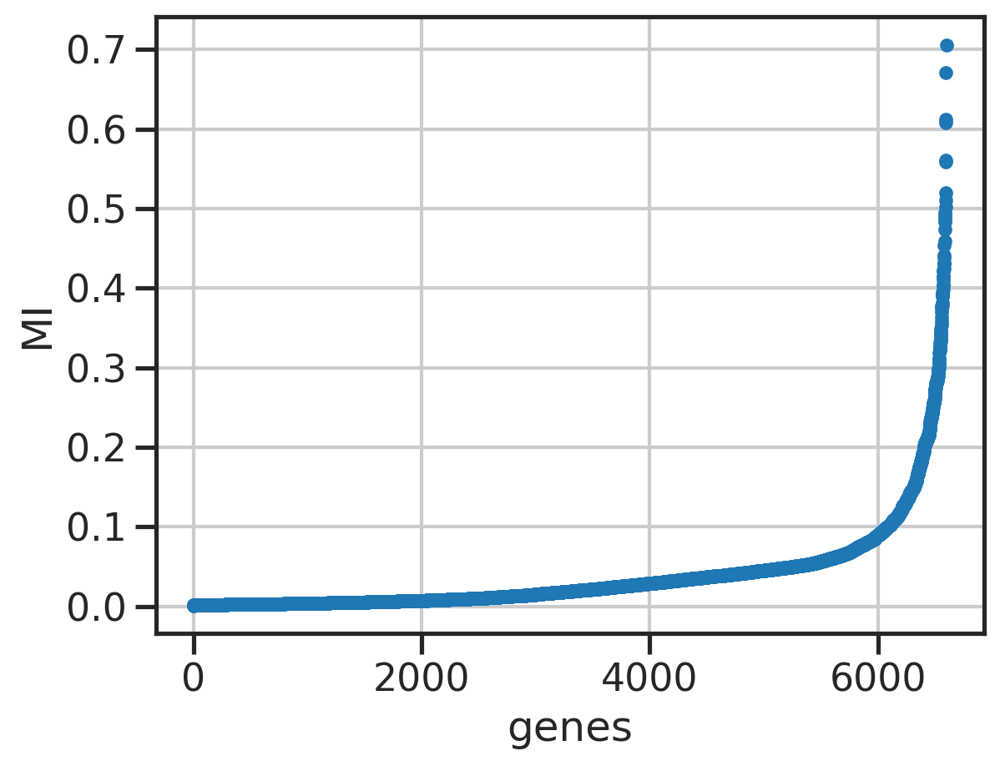

In [38]:
# np.sort(mi)[::-1][1]
plt.plot(np.sort(mi), 'o', markersize=5)
plt.xlabel('genes')
plt.ylabel('MI')

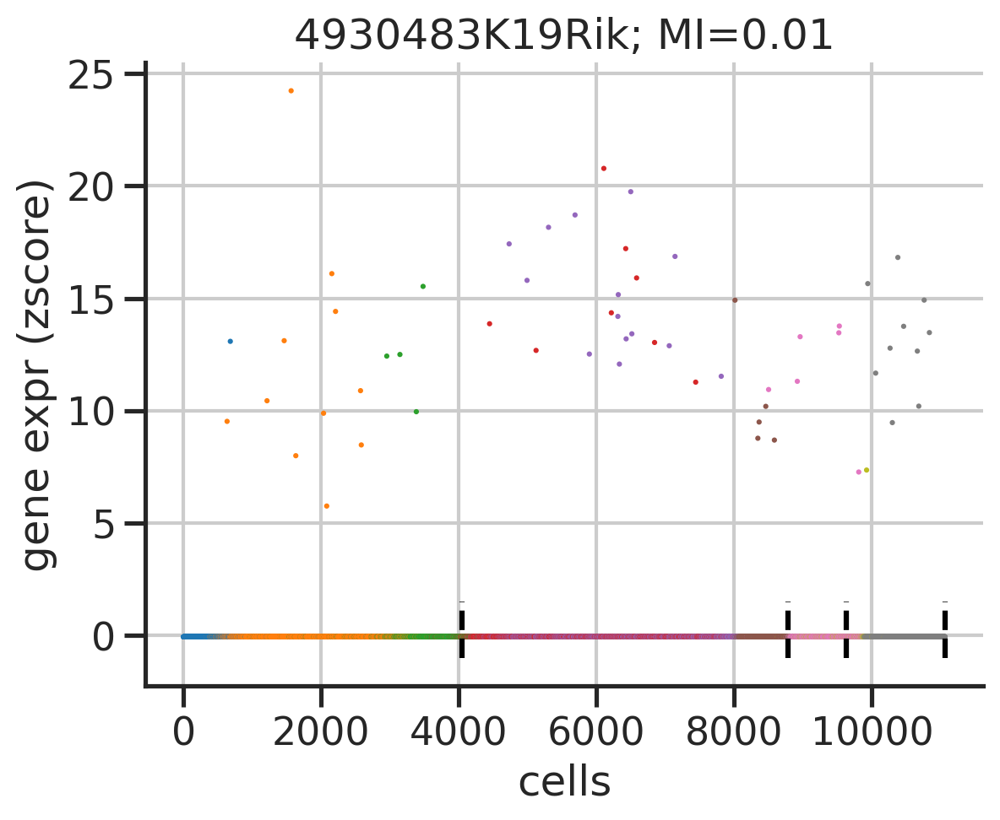

In [39]:
g = gidx_all[5000]
_mi = mi[g]
dfp = pd.DataFrame() 
dfp['x'] = np.arange(len(omat))
dfp['y'] = omat[:,g]
dfp['c'] = ressort['type'].values

fig, ax = plt.subplots()
sns.scatterplot(data=dfp, x='x', y='y', hue='c', s=5, edgecolor='none', legend=False, palette=palette_types)
# ax.scatter(np.arange(len(omat)), omat[:,g], c=, s=1)
# ax.scatter(ocpt, omat[:,g], s=1)
ax.vlines(np.cumsum(num_cells.values)[::-1], ymin=-1, ymax=1.5, color='black', linestyle='--')
ax.set_xlabel('cells')
ax.set_ylabel('gene expr (zscore)')
ax.set_title(f"{genes_sel[g]}; MI={_mi:.2f}")
sns.despine(ax=ax)

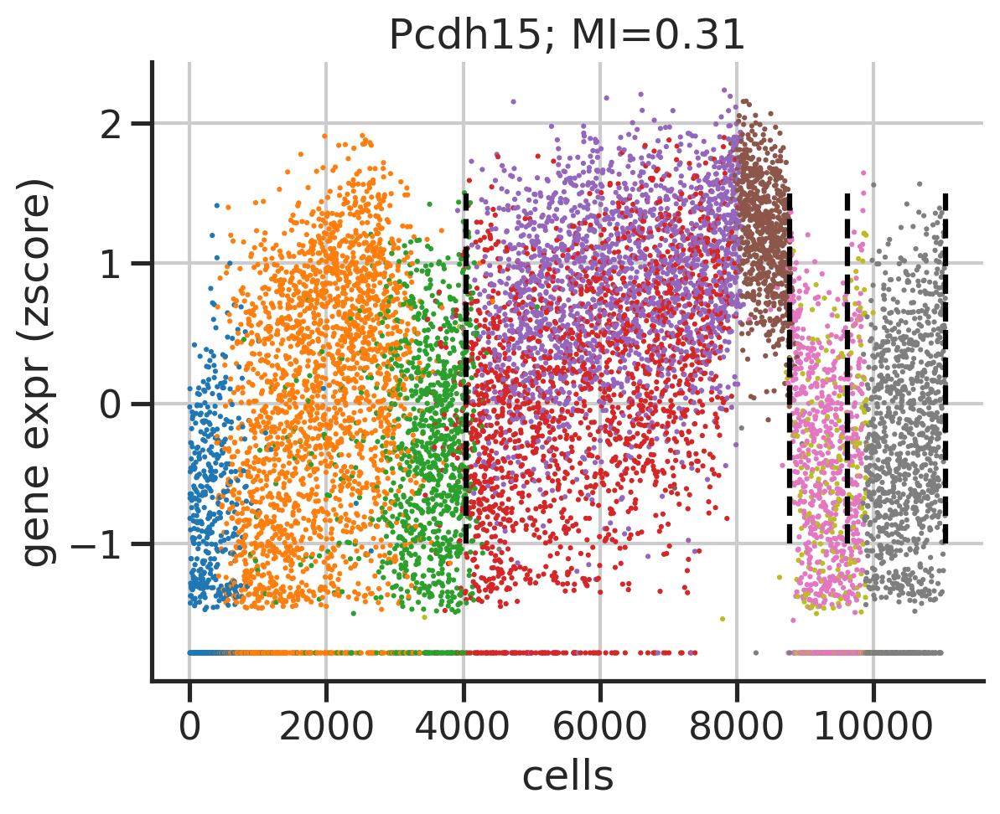

In [40]:
g = gidx_l5[0]
_mi = mi_l5[g]
dfp = pd.DataFrame() 
dfp['x'] = np.arange(len(omat))
dfp['y'] = omat[:,g]
dfp['c'] = ressort['type'].values

fig, ax = plt.subplots()
sns.scatterplot(data=dfp, x='x', y='y', hue='c', s=5, edgecolor='none', legend=False, palette=palette_types)
# ax.scatter(np.arange(len(omat)), omat[:,g], c=, s=1)
# ax.scatter(ocpt, omat[:,g], s=1)
ax.vlines(np.cumsum(num_cells.values)[::-1], ymin=-1, ymax=1.5, color='black', linestyle='--')
ax.set_xlabel('cells')
ax.set_ylabel('gene expr (zscore)')
ax.set_title(f"{genes_sel[g]}; MI={_mi:.2f}")
sns.despine(ax=ax)

In [41]:
def get_gptime(adata):
    """
    """

    lognorm = np.array(adata.layers['lognorm'].todense())
    # # gene ptime
    weights = ((lognorm+1e-10)/(lognorm.sum(axis=0)+1e-10))

    gptime  = adata.obs['dpt_pseudotime'].values.dot(weights)
    gidx = np.argsort(gptime)
    return gptime, gidx

In [42]:
choices2 = sns.color_palette('tab20', 20)
choices2

[(0.12156862745098039, 0.4666666666666667, 0.7058823529411765),
 (0.6823529411764706, 0.7803921568627451, 0.9098039215686274),
 (1.0, 0.4980392156862745, 0.054901960784313725),
 (1.0, 0.7333333333333333, 0.47058823529411764),
 (0.17254901960784313, 0.6274509803921569, 0.17254901960784313),
 (0.596078431372549, 0.8745098039215686, 0.5411764705882353),
 (0.8392156862745098, 0.15294117647058825, 0.1568627450980392),
 (1.0, 0.596078431372549, 0.5882352941176471),
 (0.5803921568627451, 0.403921568627451, 0.7411764705882353),
 (0.7725490196078432, 0.6901960784313725, 0.8352941176470589),
 (0.5490196078431373, 0.33725490196078434, 0.29411764705882354),
 (0.7686274509803922, 0.611764705882353, 0.5803921568627451),
 (0.8901960784313725, 0.4666666666666667, 0.7607843137254902),
 (0.9686274509803922, 0.7137254901960784, 0.8235294117647058),
 (0.4980392156862745, 0.4980392156862745, 0.4980392156862745),
 (0.7803921568627451, 0.7803921568627451, 0.7803921568627451),
 (0.7372549019607844, 0.7411764705882353, 0.13333333333333333),
 (0.8588235294117647, 0.8588235294117647, 0.5529411764705883),
 (0.09019607843137255, 0.7450980392156863, 0.8117647058823529),
 (0.6196078431372549, 0.8549019607843137, 0.8980392156862745)]

In [43]:
my_colors_d1 = tuple([b for a, b in palette_types.items()])
# cmap_d1 = LinearSegmentedColormap.from_list('', my_colors, len(my_colors))

my_colors = tuple(list(choices2[6:8])+list(choices2[14:16]))
cmap_d2 = LinearSegmentedColormap.from_list('', my_colors, len(my_colors))

# ncell, ngene = zlognorm.shape

In [44]:
def plot_heatmap(zlognorm, cellidx, geneidx,
                 types, samps, 
                 cmap_d1,
                 cmap_d2,
                 title="",
                ):
    """
    """
    mosaic = ("."+"A"*20+"\n")*10 + ("."+"C"*20+"\n") + ("."+"D"*20+"\n")

    fig, axdict = plt.subplot_mosaic(mosaic, figsize=(12,7))
    ax = axdict['A']
    sns.heatmap(zlognorm[cellidx][:,geneidx].T,
                xticklabels=False,
                yticklabels=20,
                cbar_kws=dict(shrink=0.3, label='zscore log10CP10k', aspect=10),
                center=0,
                vmax=3,
                vmin=-3,
                cmap='coolwarm',
                rasterized=True,
                ax=ax,
               )
    ax.set_yticklabels(ax.get_yticklabels(), rotation=0, fontsize=10)
    ax.set_ylabel('Genes')

    ax = axdict['C']
    sns.heatmap(pd.factorize(types[cellidx], sort=True)[0].reshape(-1,1).T, 
                xticklabels=False,
                yticklabels=False,
                cmap=cmap_d1,
                cbar_kws=dict(ticks=[], shrink=1.2, aspect=3, label='type'),
                rasterized=True,
                ax=ax, 
               )
    fig.axes[-1].set_ylabel(fig.axes[-1].get_ylabel(), rotation=0, ha='left')

    ax = axdict['D']
    sns.heatmap(pd.factorize(samps[cellidx], sort=True)[0].reshape(-1,1).T, 
                xticklabels=1000,
                yticklabels=False,
                cmap=cmap_d2,
                cbar_kws=dict(ticks=[], shrink=1.2, aspect=3, label='sample'),
                rasterized=True,
                ax=ax, 
               )
    ax.set_xlabel('Cells')
    fig.axes[-1].set_ylabel(fig.axes[-1].get_ylabel(), rotation=0, ha='left')
    ax.set_yticklabels(ax.get_yticklabels(), rotation=0, fontsize=10)
    ax.set_xticklabels(ax.get_xticklabels(), rotation=0, fontsize=10)

    fig.subplots_adjust(hspace=0.5)
    fig.suptitle(title, fontsize=15)
    # powerplots.savefig_autodate(fig, os.path.join(outdir_fig, f'heatmap_{sample}_v4.pdf'))
    plt.show()
    
def run_heatmap(adata, genes_grad_this, cells_this, ptime_cells_this=None):
    """
    """
    print(len(genes_grad_this))
    
    if ptime_cells_this is None:
        ptime_cells_this = cells_this

    # get gene order
    adata_gptime_this = adata[adata.obs['Subclass'].isin(ptime_cells_this), genes_grad_this]
    gptime_this, gptime_idx_this = get_gptime(adata_gptime_this)
    
    # get cell order
    adata_grad_this = adata[adata.obs['Subclass'].isin(cells_this), genes_grad_this]
    zlognorm_this = zscore(np.array(adata_grad_this.layers['lognorm'].todense()), axis=0)
    cellidx_this = np.argsort(adata_grad_this.obs['dpt_pseudotime'])
    types_this = adata_grad_this.obs['easitype']
    samps_this = adata_grad_this.obs['sample']

    # plot
    my_colors_d1 = [palette_types[i] for i in np.unique(types_this)]
    if len(my_colors_d1) == 1:
        my_colors_d1 = [(0,0,0)] + my_colors_d1
    cmap_d1 = LinearSegmentedColormap.from_list('', my_colors_d1, len(my_colors_d1))
    plot_heatmap(zlognorm_this, cellidx_this, gptime_idx_this,
                 types_this, samps_this, 
                 cmap_d1, cmap_d2, title=",".join(cells_this)+"\nOrdered by "+",".join(ptime_cells_this))

132


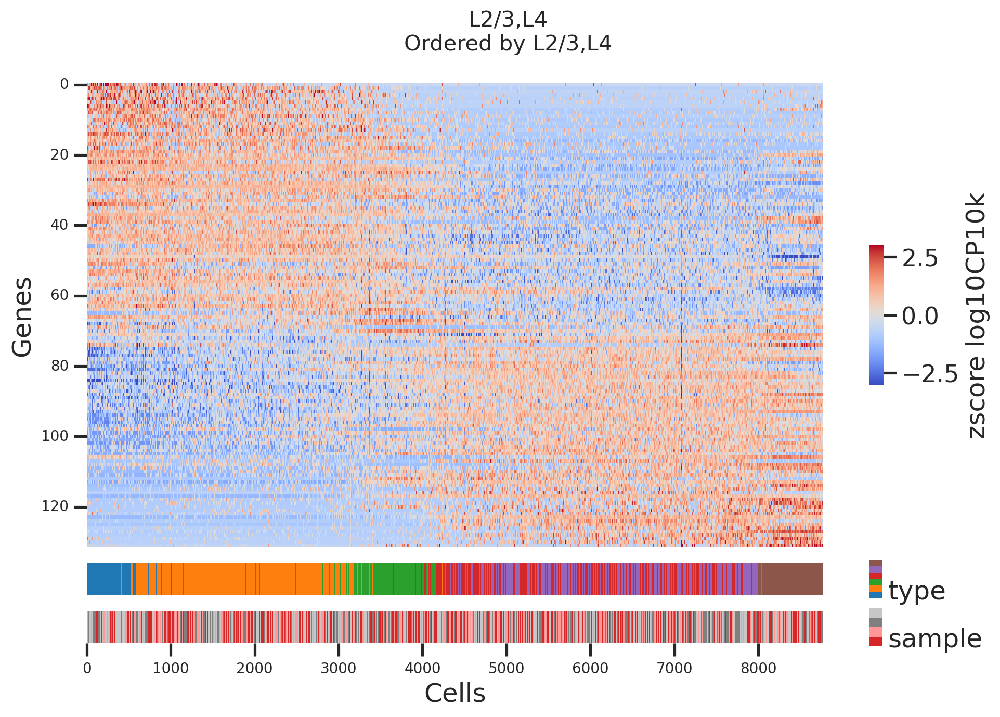

In [45]:
mi_this = mi_l234
cells_this = ['L2/3', 'L4']
genes_grad_this = genes_sel[mi_this > 0.2]
run_heatmap(adata, genes_grad_this, cells_this)

94


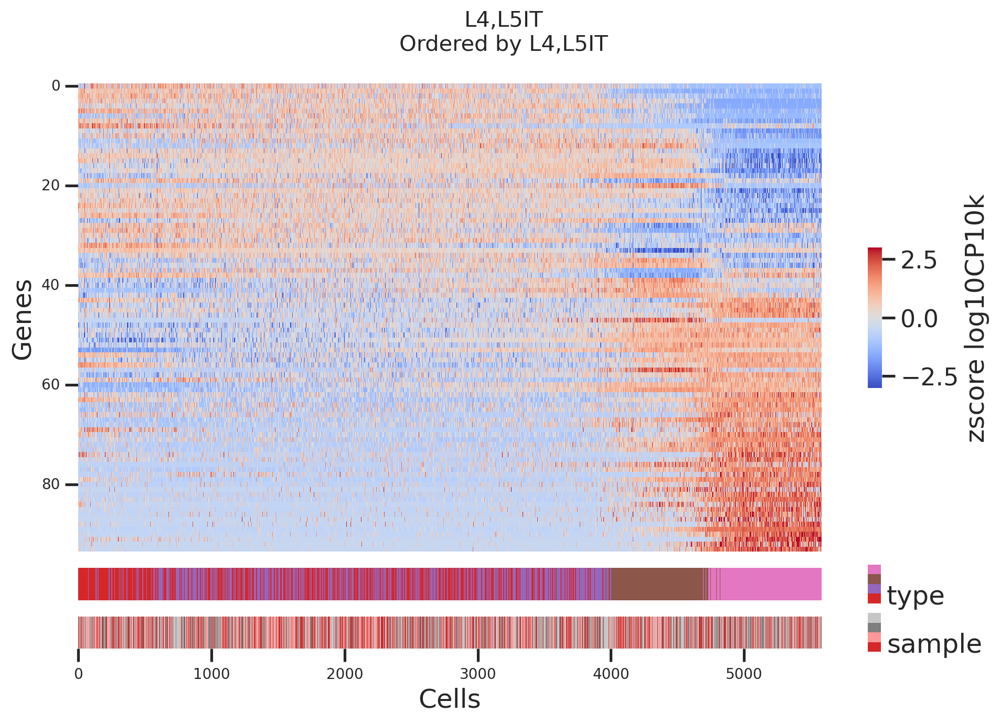

In [46]:
mi_this = mi_l45
cells_this = ['L4', 'L5IT']
genes_grad_this = genes_sel[mi_this > 0.2]
run_heatmap(adata, genes_grad_this, cells_this)

176


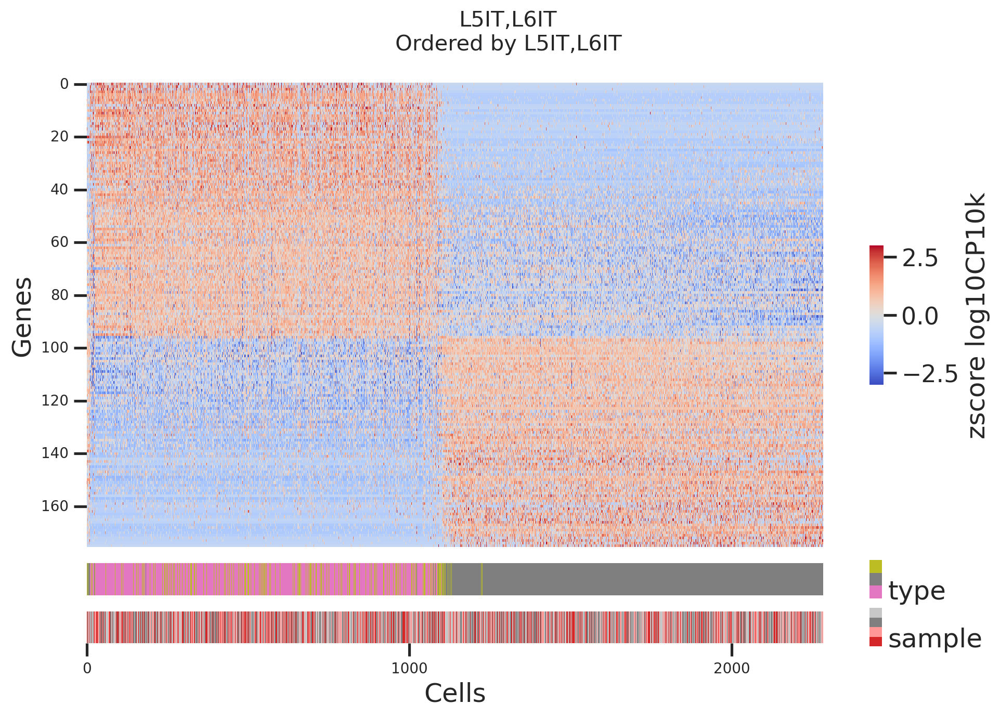

In [47]:
mi_this = mi_l56
cells_this = ['L5IT', 'L6IT']
genes_grad_this = genes_sel[mi_this > 0.2]
run_heatmap(adata, genes_grad_this, cells_this)

48


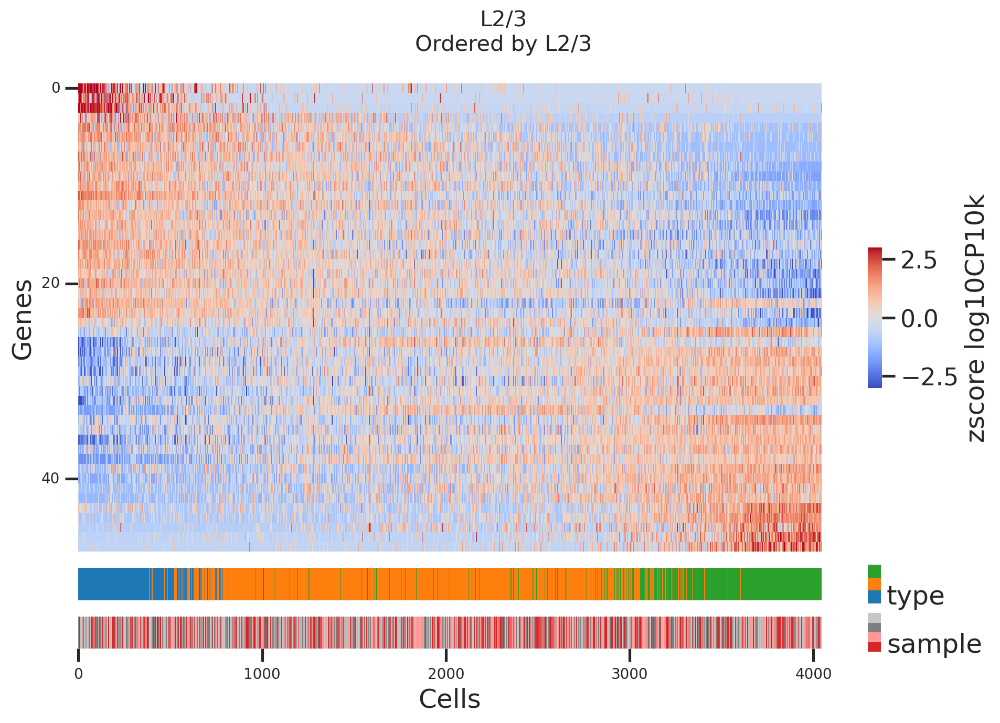

In [48]:
mi_this = mi_l23
cells_this = ['L2/3']
genes_grad_this = genes_sel[mi_this > 0.2]
run_heatmap(adata, genes_grad_this, cells_this)

30


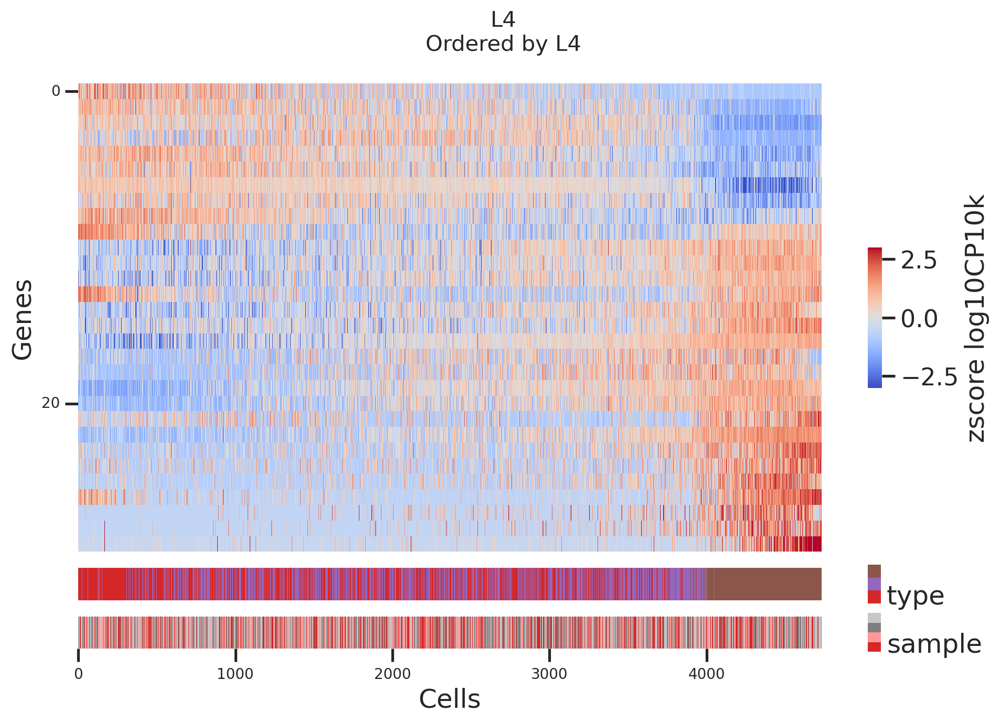

In [49]:
mi_this = mi_l4
cells_this = ['L4']
genes_grad_this = genes_sel[mi_this > 0.2]
run_heatmap(adata, genes_grad_this, cells_this)

134


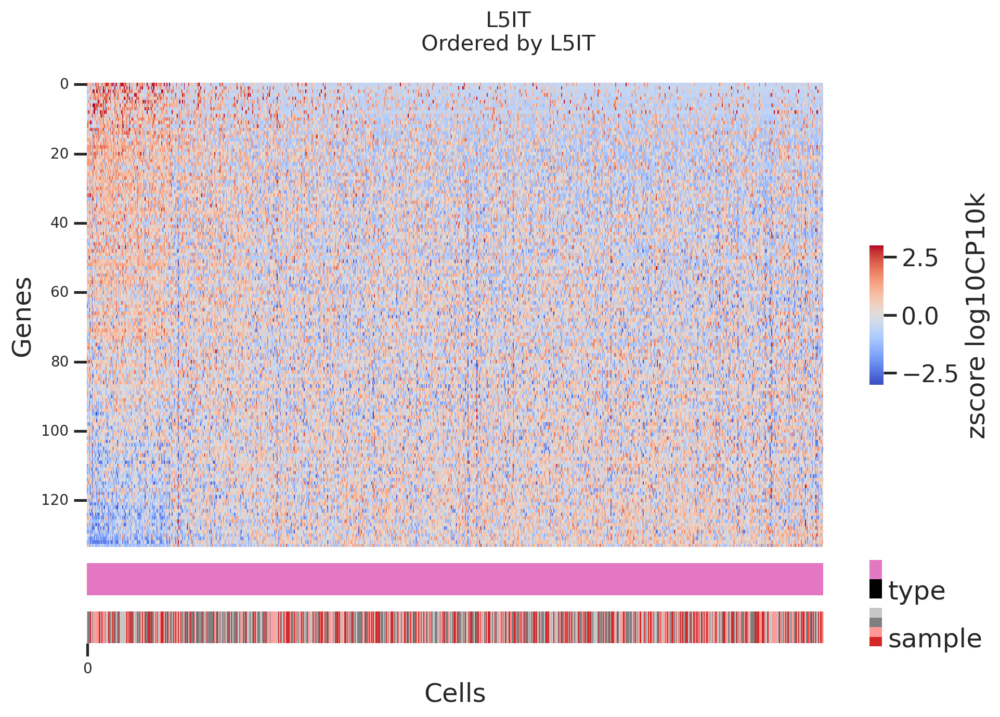

In [50]:
mi_this = mi_l5
cells_this = ['L5IT']
genes_grad_this = genes_sel[mi_this > 0.2]
run_heatmap(adata, genes_grad_this, cells_this)

135


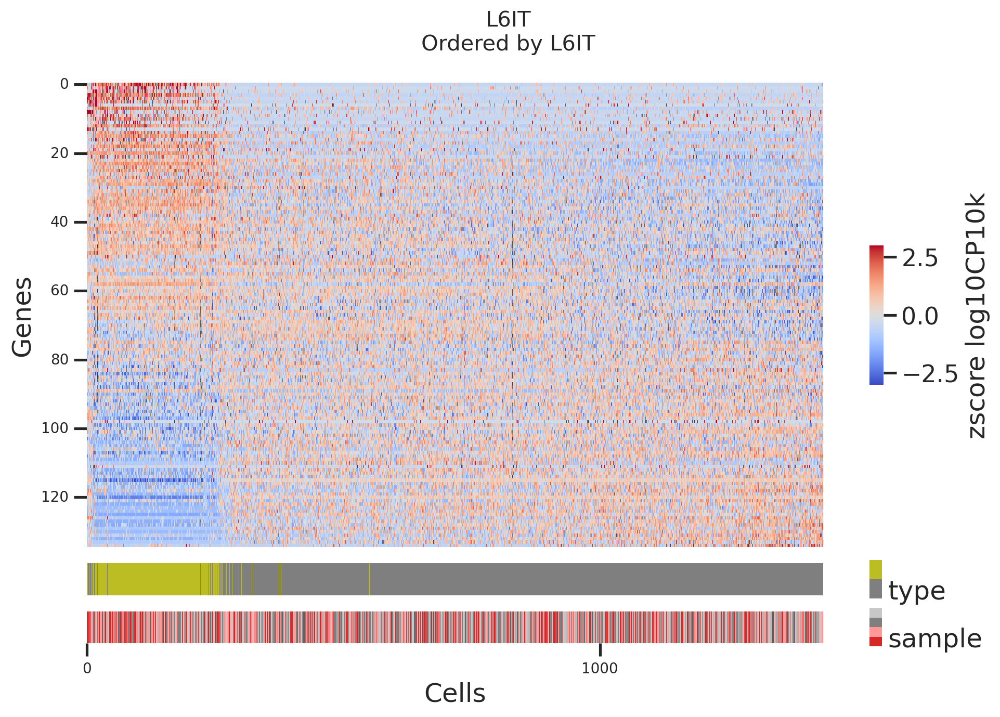

In [51]:
mi_this = mi_l6
cells_this = ['L6IT']
genes_grad_this = genes_sel[mi_this > 0.2]
run_heatmap(adata, genes_grad_this, cells_this)

270


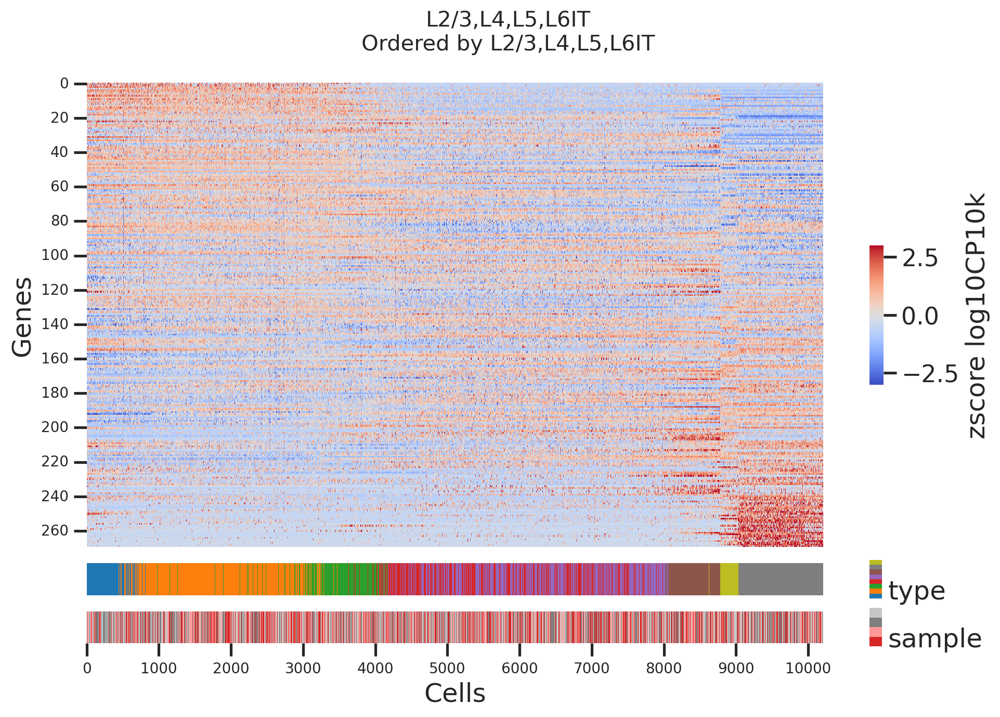

In [52]:
cells_this = ['L2/3', 'L4', 'L5', 'L6IT']
cond = np.any(
    [
        mi_l234>0.2,
        mi_l45>0.2,
        mi_l56>0.2,
    ], axis=0)

genes_grad_this = genes_sel[cond]
run_heatmap(adata, genes_grad_this, cells_this)

# combined

338


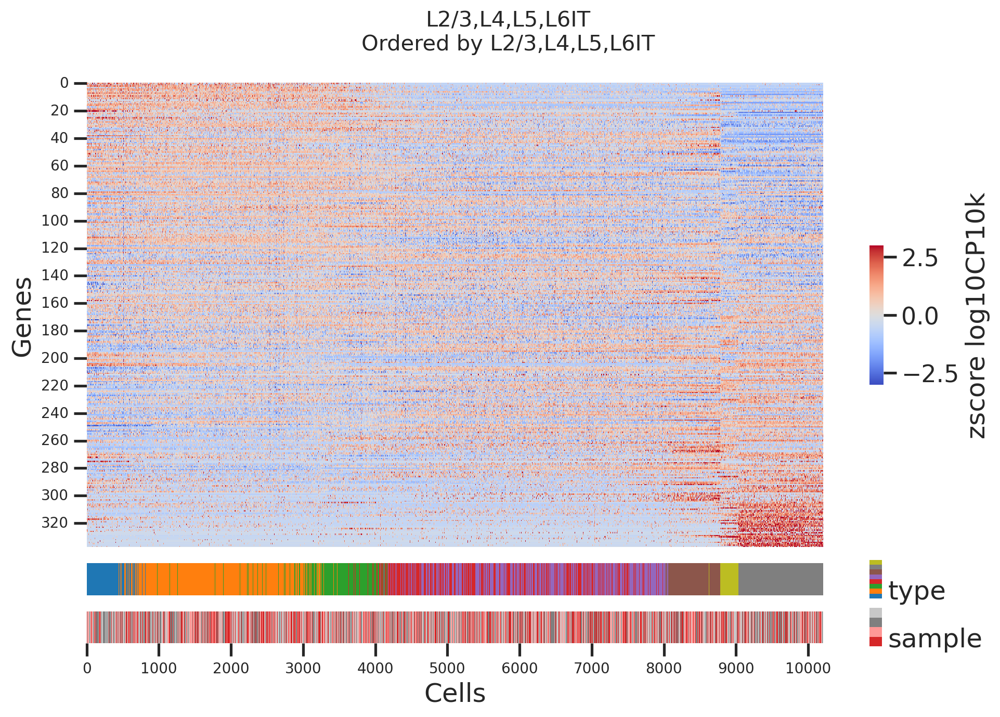

In [53]:
cells_this = ['L2/3', 'L4', 'L5', 'L6IT']
cond = np.any(
    [
        mi_l234>0.2,
        mi_l45>0.2,
        mi_l56>0.2,
        
        mi_l23>0.2,
        mi_l4>0.2,
        mi_l5>0.2,
        mi_l6>0.2,
    ], axis=0)

genes_grad_this = genes_sel[cond]
run_heatmap(adata, genes_grad_this, cells_this)

338


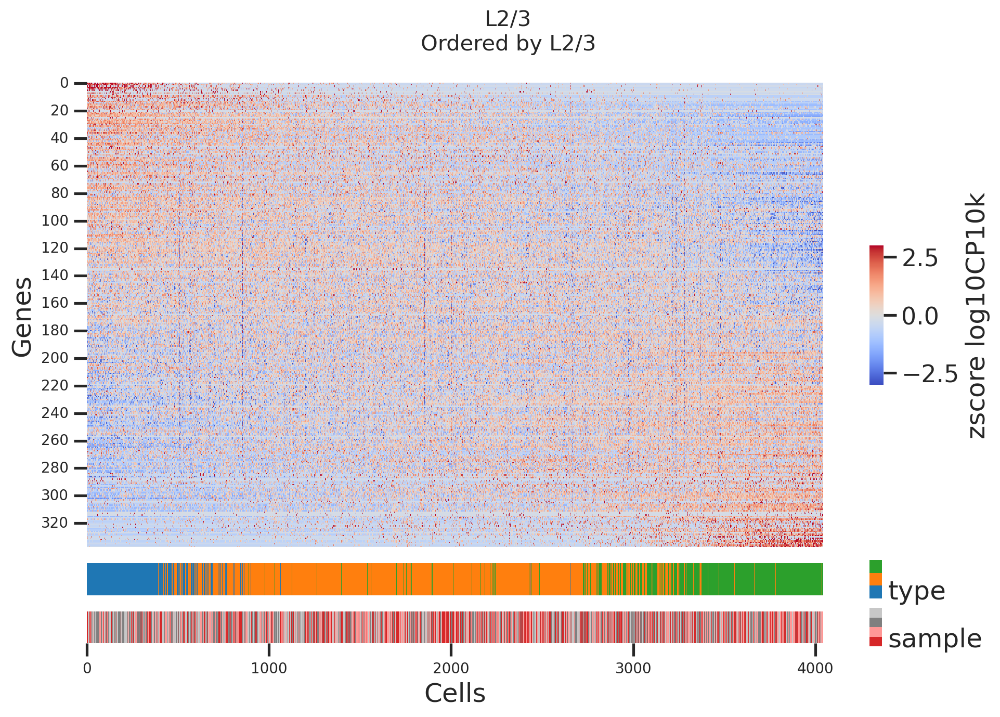

In [54]:
cells_this = ['L2/3']
cond = np.any(
    [
        mi_l234>0.2,
        mi_l45>0.2,
        mi_l56>0.2,
        
        mi_l23>0.2,
        mi_l4>0.2,
        mi_l5>0.2,
        mi_l6>0.2,
    ], axis=0)

genes_grad_this = genes_sel[cond]
run_heatmap(adata, genes_grad_this, cells_this)

338


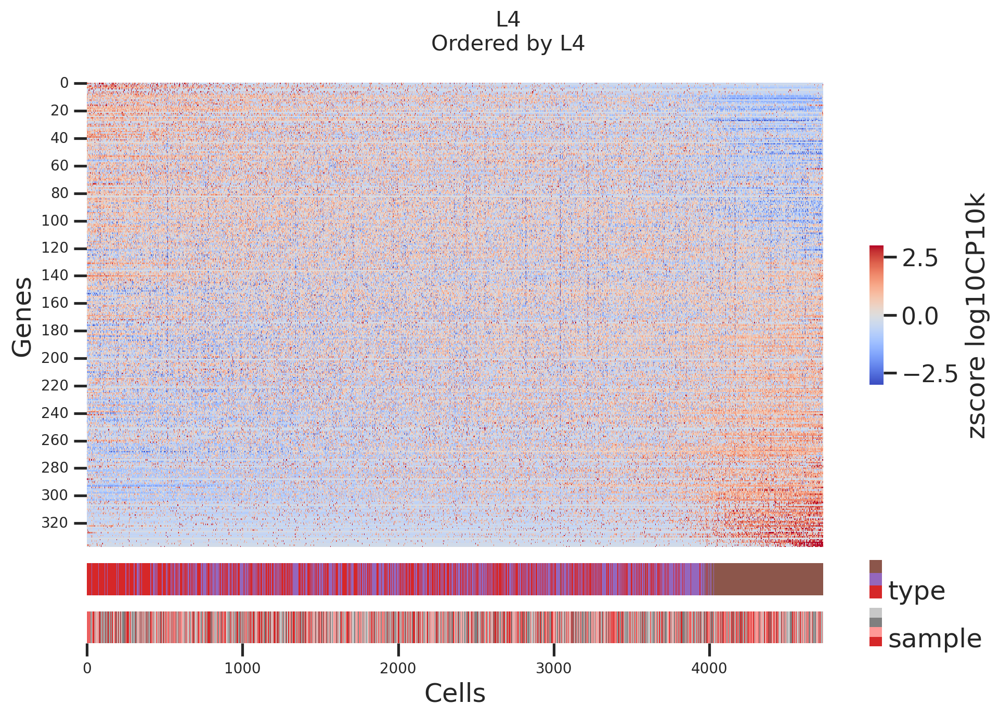

In [55]:
cells_this = ['L4']
cond = np.any(
    [
        mi_l234>0.2,
        mi_l45>0.2,
        mi_l56>0.2,
        
        mi_l23>0.2,
        mi_l4>0.2,
        mi_l5>0.2,
        mi_l6>0.2,
    ], axis=0)

genes_grad_this = genes_sel[cond]
run_heatmap(adata, genes_grad_this, cells_this)

338


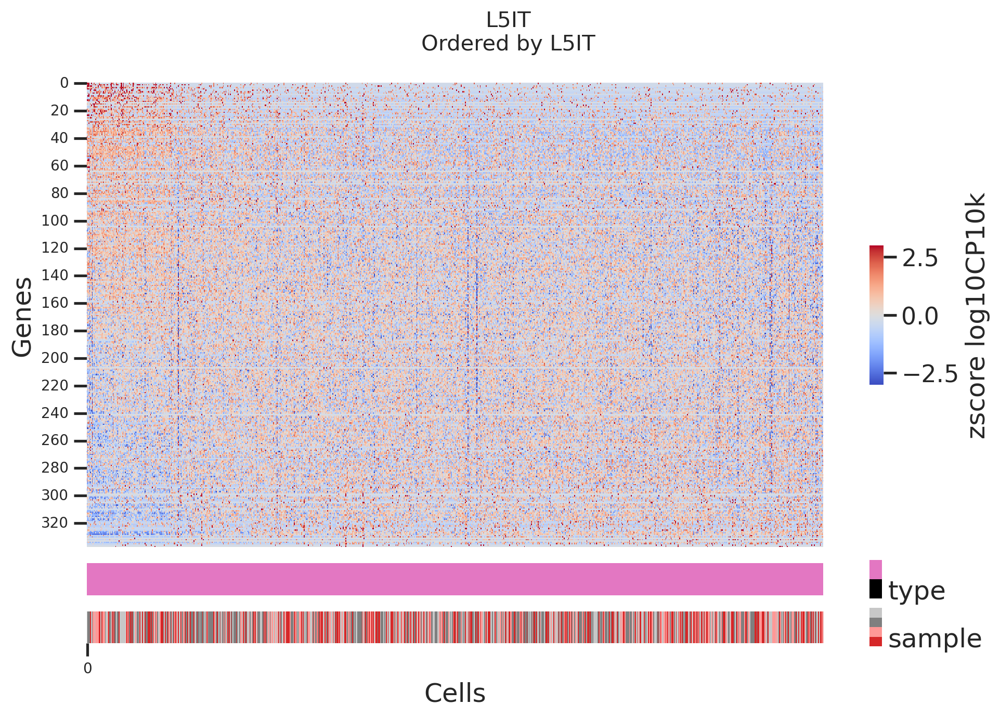

In [56]:
cells_this = ['L5IT']
cond = np.any(
    [
        mi_l234>0.2,
        mi_l45>0.2,
        mi_l56>0.2,
        
        mi_l23>0.2,
        mi_l4>0.2,
        mi_l5>0.2,
        mi_l6>0.2,
    ], axis=0)

genes_grad_this = genes_sel[cond]
run_heatmap(adata, genes_grad_this, cells_this)

338


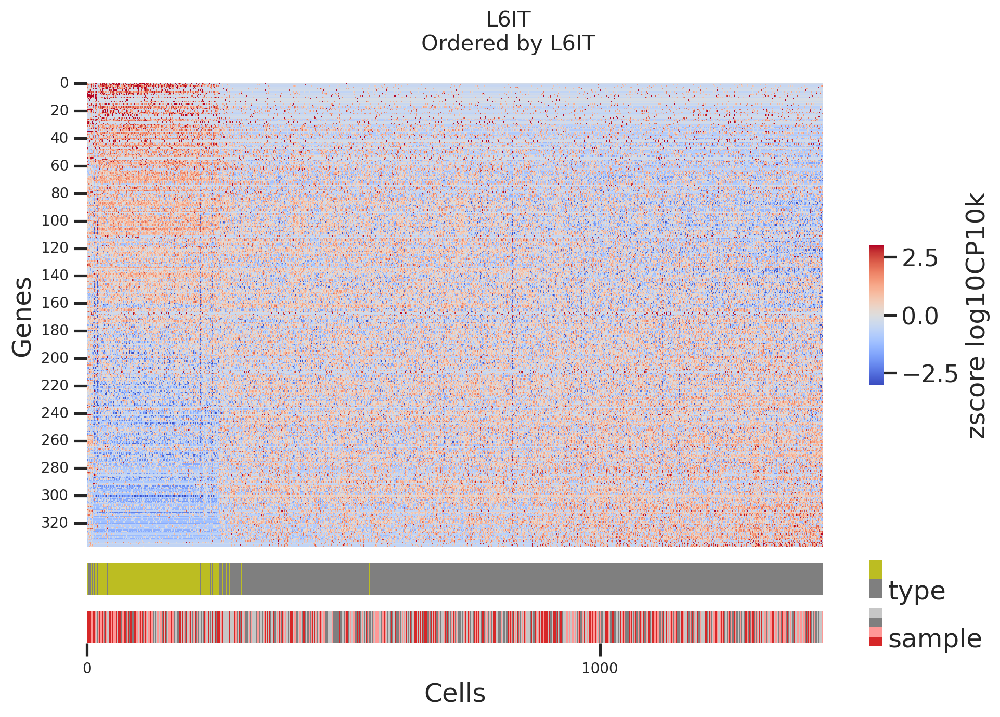

In [57]:
cells_this = ['L6IT']
ptime_cells_this = ['L2/3', 'L6IT']
cond = np.any(
    [
        mi_l234>0.2,
        mi_l45>0.2,
        mi_l56>0.2,
        
        mi_l23>0.2,
        mi_l4>0.2,
        mi_l5>0.2,
        mi_l6>0.2,
    ], axis=0)

genes_grad_this = genes_sel[cond]
run_heatmap(adata, genes_grad_this, cells_this)

# order all things differently

270


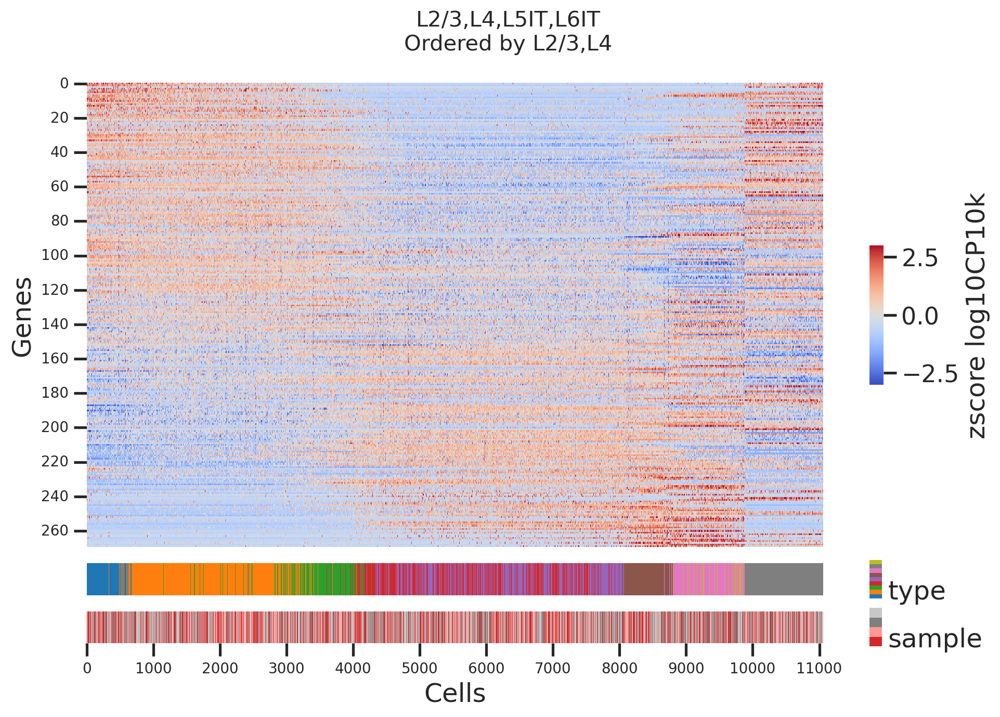

In [58]:
cells_this = ['L2/3', 'L4', 'L5IT', 'L6IT']
ptime_cells_this = ['L2/3', 'L4'] #, 'L5IT', 'L6IT']
cond = np.any([
    mi_l234 > 0.2,
    mi_l45 > 0.2,
    mi_l56 > 0.2,
    ], axis=0) 

genes_grad_this = genes_sel[cond]
run_heatmap(adata, genes_grad_this, cells_this, ptime_cells_this)

270


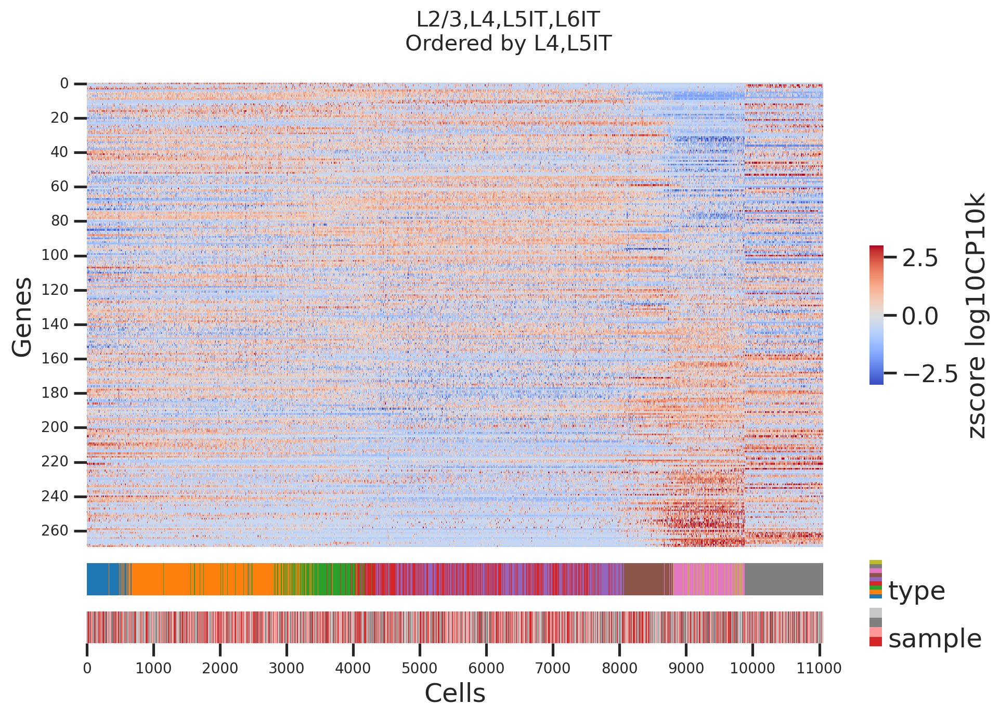

In [59]:
cells_this = ['L2/3', 'L4', 'L5IT', 'L6IT']
ptime_cells_this = ['L4', 'L5IT'] #, 'L5IT', 'L6IT']
cond = np.any([
    mi_l234 > 0.2,
    mi_l45 > 0.2,
    mi_l56 > 0.2,
    ], axis=0) 

genes_grad_this = genes_sel[cond]
run_heatmap(adata, genes_grad_this, cells_this, ptime_cells_this)

270


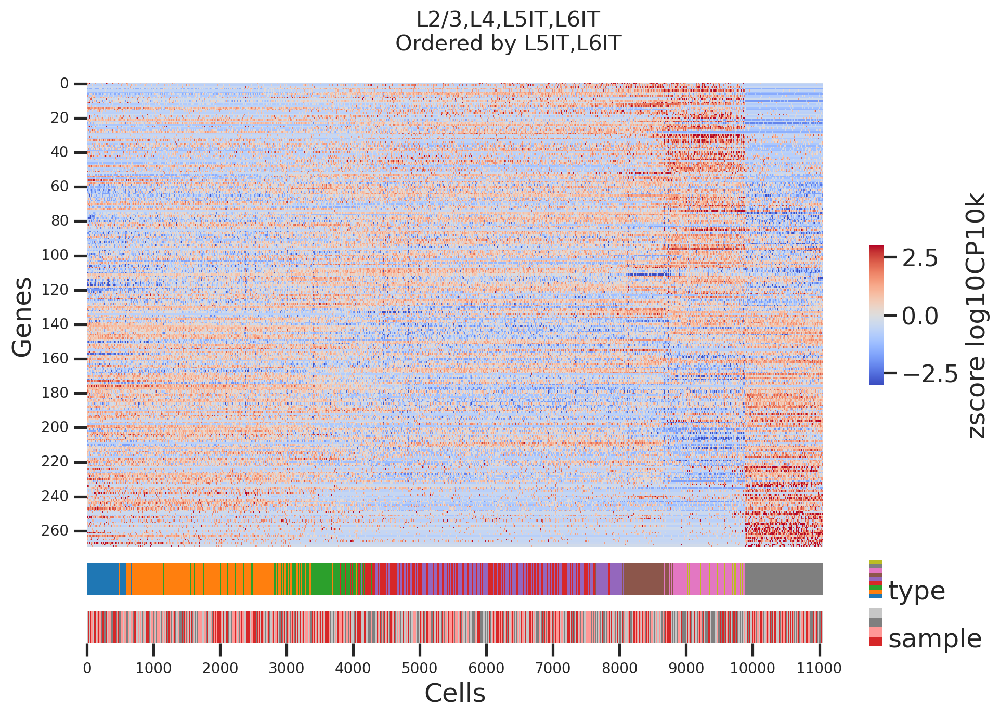

In [60]:
cells_this = ['L2/3', 'L4', 'L5IT', 'L6IT']
ptime_cells_this = ['L5IT', 'L6IT'] #, 'L5IT', 'L6IT']
cond = np.any([
    mi_l234 > 0.2,
    mi_l45 > 0.2,
    mi_l56 > 0.2,
    ], axis=0) 

genes_grad_this = genes_sel[cond]
run_heatmap(adata, genes_grad_this, cells_this, ptime_cells_this)

270


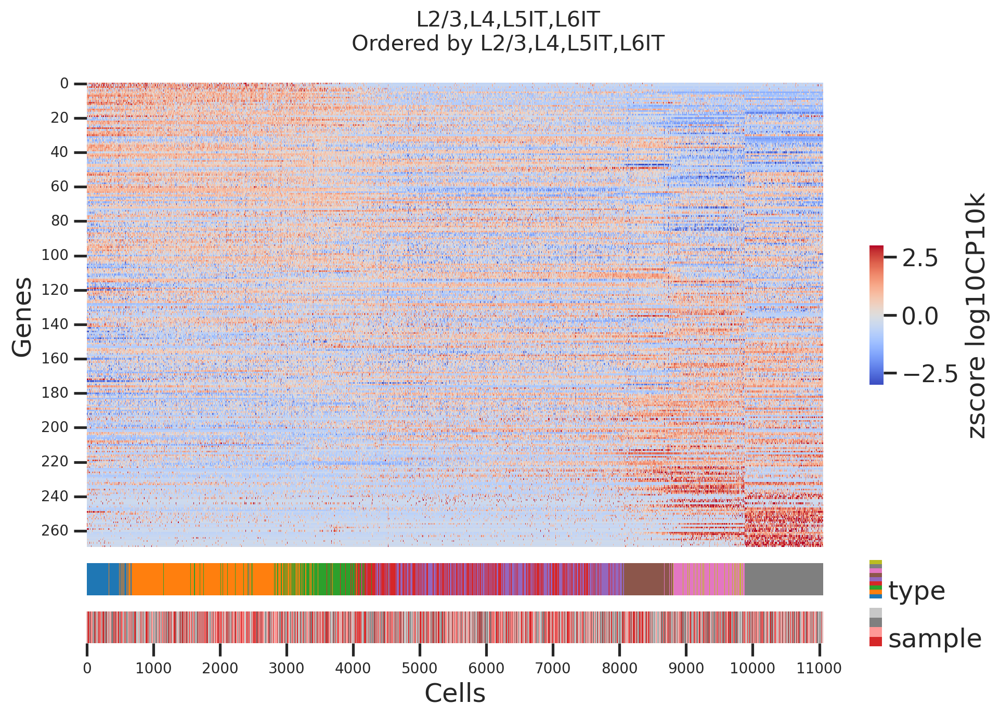

In [61]:
cells_this = ['L2/3', 'L4', 'L5IT', 'L6IT']
ptime_cells_this = ['L2/3', 'L4', 'L5IT', 'L6IT'] #, 'L5IT', 'L6IT']
cond = np.any([
    mi_l234 > 0.2,
    mi_l45 > 0.2,
    mi_l56 > 0.2,
    ], axis=0) 

genes_grad_this = genes_sel[cond]
run_heatmap(adata, genes_grad_this, cells_this, ptime_cells_this)

48


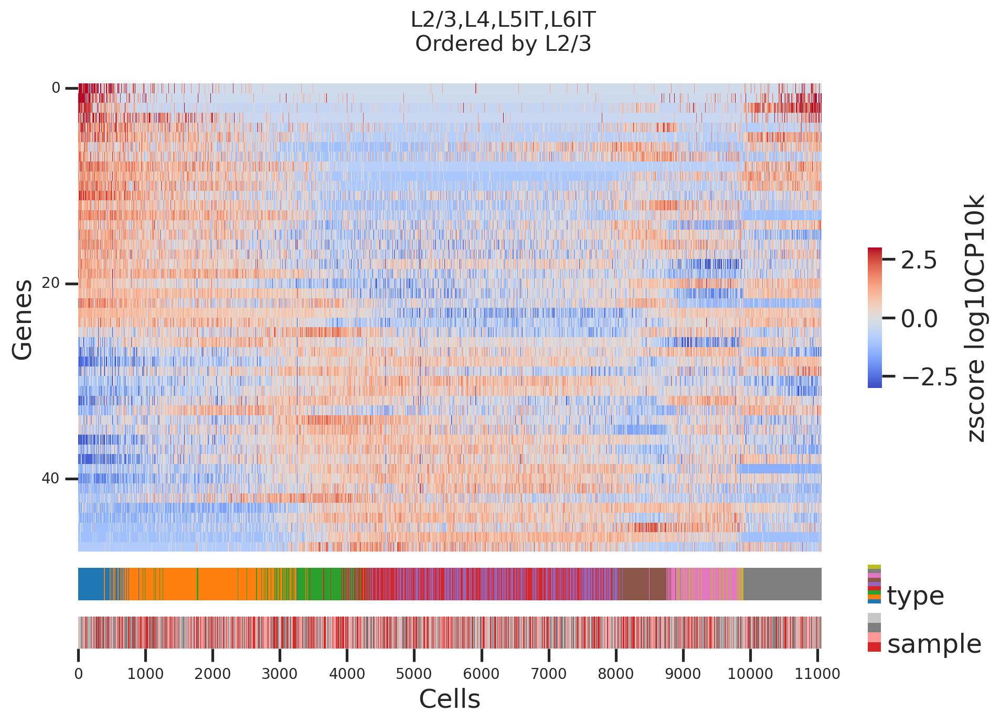

In [62]:
cells_this = ['L2/3', 'L4', 'L5IT', 'L6IT']
ptime_cells_this = ['L2/3'] #, 'L5IT', 'L6IT']
cond = np.any([
    # mi_l234 > 0.2,
    # mi_l45 > 0.2,
    # mi_l56 > 0.2,
    
    mi_l23 > 0.2,
    # mi_l4 > 0.2,
    # mi_l5 > 0.2,
    # mi_l6 > 0.2,
    ], axis=0) 

genes_grad_this = genes_sel[cond]
run_heatmap(adata, genes_grad_this, cells_this, ptime_cells_this)

338


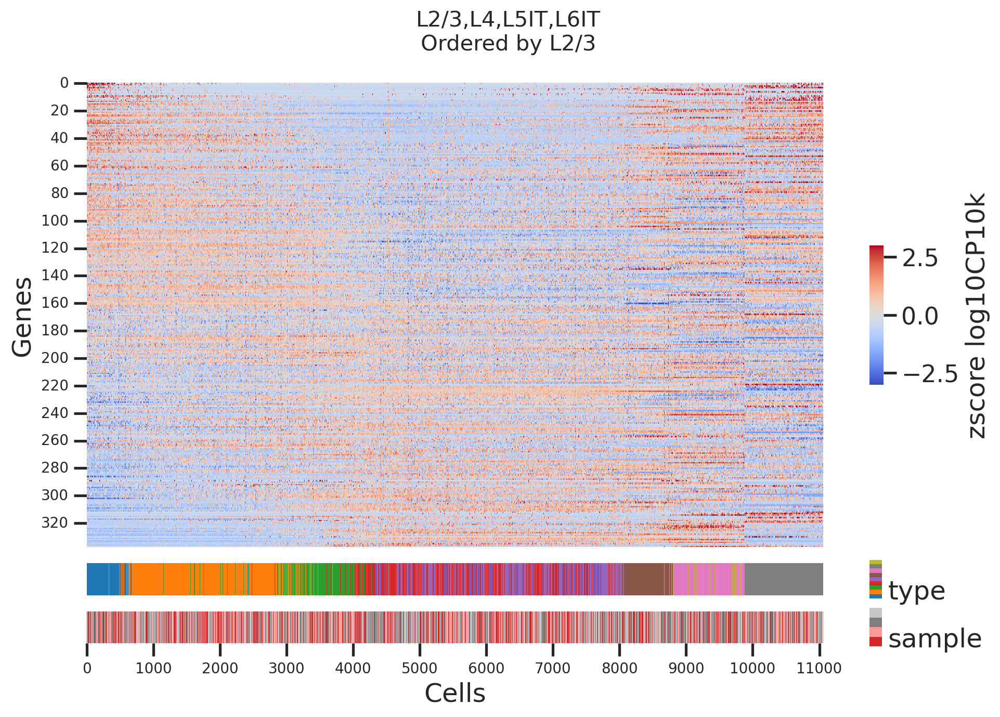

In [63]:
cells_this = ['L2/3', 'L4', 'L5IT', 'L6IT']
ptime_cells_this = ['L2/3'] #, 'L5IT', 'L6IT']
cond = np.any([
    mi_l234 > 0.2,
    mi_l45 > 0.2,
    mi_l56 > 0.2,
    
    mi_l23 > 0.2,
    mi_l4 > 0.2,
    mi_l5 > 0.2,
    mi_l6 > 0.2,
    ], axis=0) 

genes_grad_this = genes_sel[cond]
run_heatmap(adata, genes_grad_this, cells_this, ptime_cells_this)

# Modes of genes
- gene co-expression or clustering

338


/home/qlyu/mambaforge/envs/bbbroutine/lib/python3.8/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


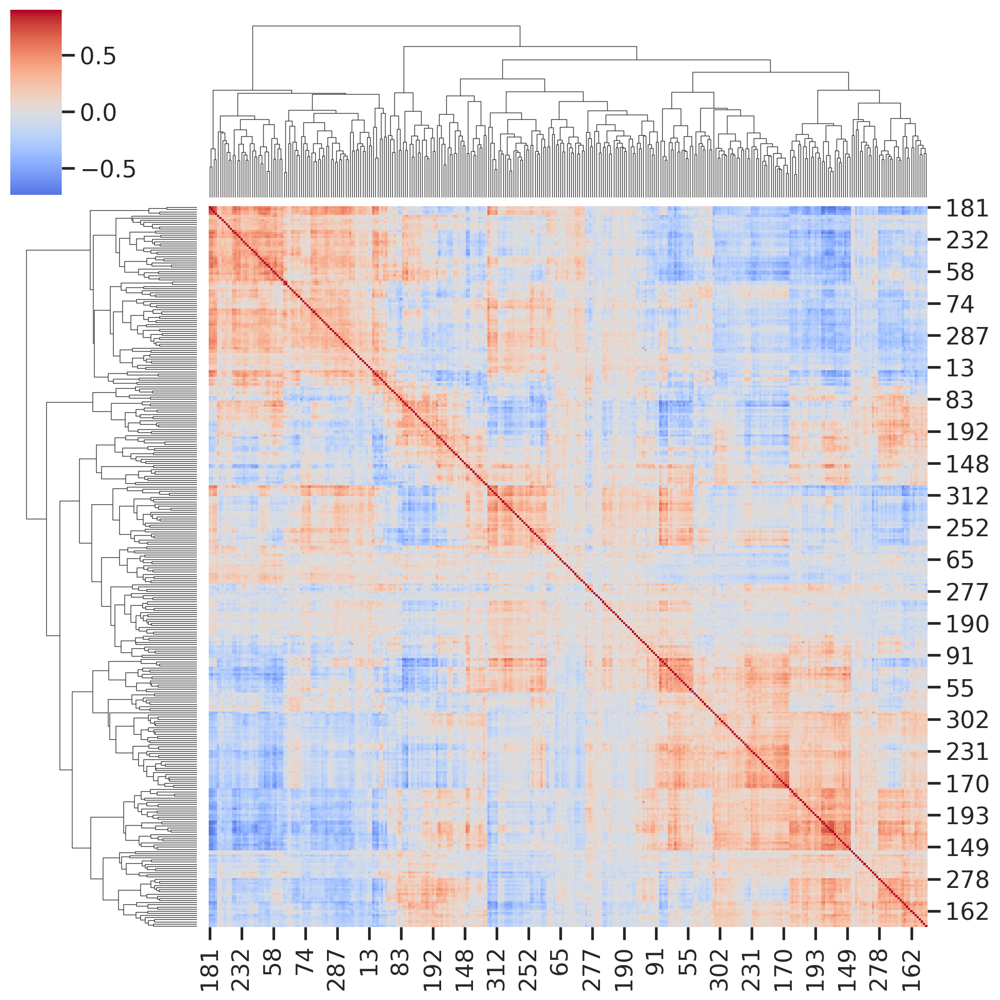

In [72]:
cond = np.any([
    mi_l234 > 0.2,
    mi_l45 > 0.2,
    mi_l56 > 0.2,
    
    mi_l23 > 0.2,
    mi_l4 > 0.2,
    mi_l5 > 0.2,
    mi_l6 > 0.2,
    ], axis=0) 
print(cond.sum())

adata_gg = adata[:, cond]
# correlation for every pair of genes
ftrs_gg = zscore(np.array(adata_gg.layers['lognorm'].todense()), axis=0).T
corr = 1/ftrs_gg.shape[1]*ftrs_gg.dot(ftrs_gg.T)
sns.clustermap(corr, cmap='coolwarm', center=0, vmax=0.9)

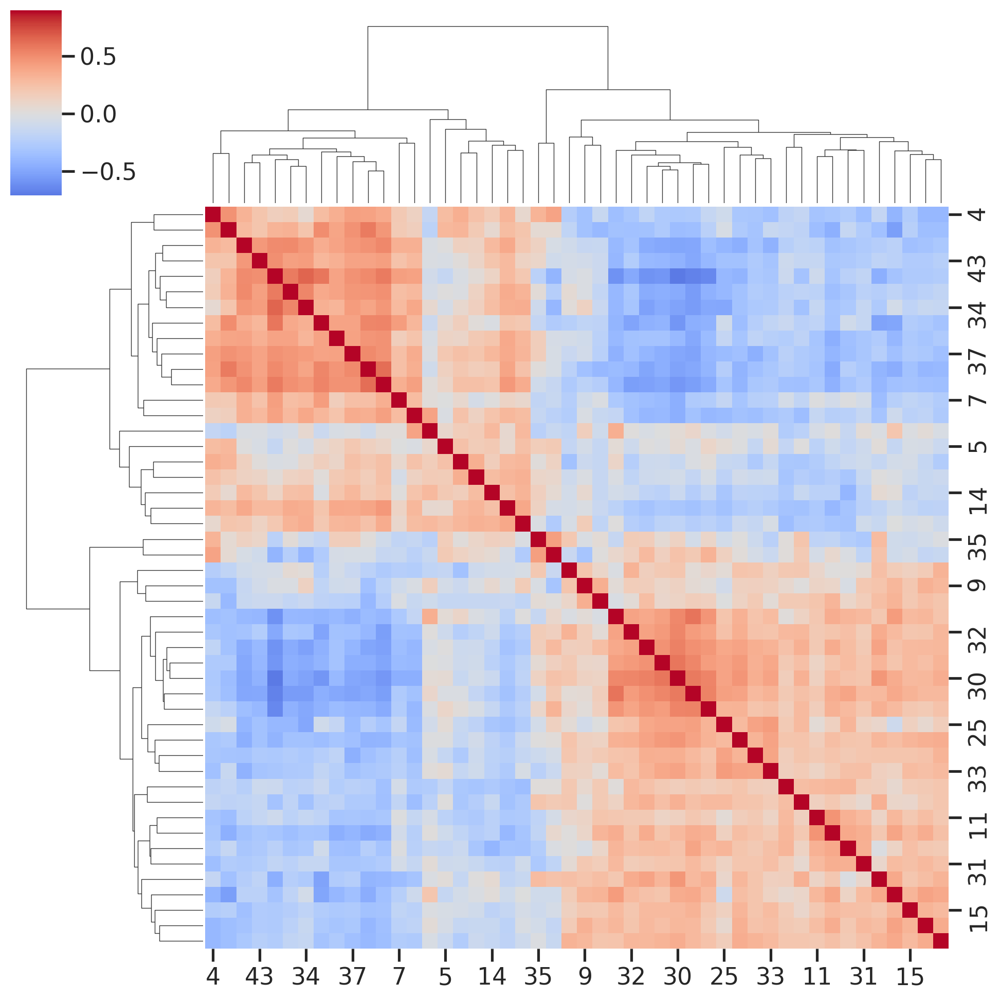

In [65]:
cond = np.any([
#     mi_l234 > 0.2,
#     mi_l45 > 0.2,
#     mi_l56 > 0.2,
    
    mi_l23 > 0.2,
    # mi_l4 > 0.2,
    # mi_l5 > 0.2,
    # mi_l6 > 0.2,
    ], axis=0) 
cond.sum()

adata_gg = adata[:, cond]
# correlation for every pair of genes
ftrs_gg = zscore(np.array(adata_gg.layers['lognorm'].todense()), axis=0).T
corr = 1/ftrs_gg.shape[1]*ftrs_gg.dot(ftrs_gg.T)
sns.clustermap(corr, cmap='coolwarm', center=0, vmax=0.9)

In [66]:
def run_heatmap_v2(adata, genes_grad_this, cells_this, gptime_idx_this):
    """
    """
    # print(cond.sum())
    
#     if ptime_cells_this is None:
#         ptime_cells_this = cells_this

#     # get gene order
#     adata_gptime_this = adata[adata.obs['Subclass'].isin(ptime_cells_this), genes_grad_this]
#     gptime_this, gptime_idx_this = get_gptime(adata_gptime_this)
    # gptime_idx_this
    
    # get cell order
    adata_grad_this = adata[adata.obs['Subclass'].isin(cells_this), genes_grad_this]
    zlognorm_this = zscore(np.array(adata_grad_this.layers['lognorm'].todense()), axis=0)
    cellidx_this = np.argsort(adata_grad_this.obs['dpt_pseudotime'])
    types_this = adata_grad_this.obs['easitype']
    samps_this = adata_grad_this.obs['sample']

    # plot
    my_colors_d1 = [palette_types[i] for i in np.unique(types_this)]
    if len(my_colors_d1) == 1:
        my_colors_d1 = [(0,0,0)] + my_colors_d1
    cmap_d1 = LinearSegmentedColormap.from_list('', my_colors_d1, len(my_colors_d1))
    plot_heatmap(zlognorm_this, cellidx_this, gptime_idx_this,
                 types_this, samps_this, 
                 cmap_d1, cmap_d2, title=",".join(cells_this)+"\nOrdered by "+",".join(ptime_cells_this))

In [67]:
cond = np.any([
#     mi_l234 > 0.2,
#     mi_l45 > 0.2,
#     mi_l56 > 0.2,
    
    mi_l23 > 0.2,
    # mi_l4 > 0.2,
    # mi_l5 > 0.2,
    # mi_l6 > 0.2,
    ], axis=0) 
cond.sum()

adata_gg = adata[:, cond]
# correlation for every pair of genes
ftrs_gg = zscore(np.array(adata_gg.layers['lognorm'].todense()), axis=0).T
kmeans = KMeans(n_clusters=10)
lbls_gg = kmeans.fit_predict(ftrs_gg)
# sns.clustermap(corr, cmap='coolwarm', center=0, vmax=0.9)

/home/qlyu/mambaforge/envs/bbbroutine/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


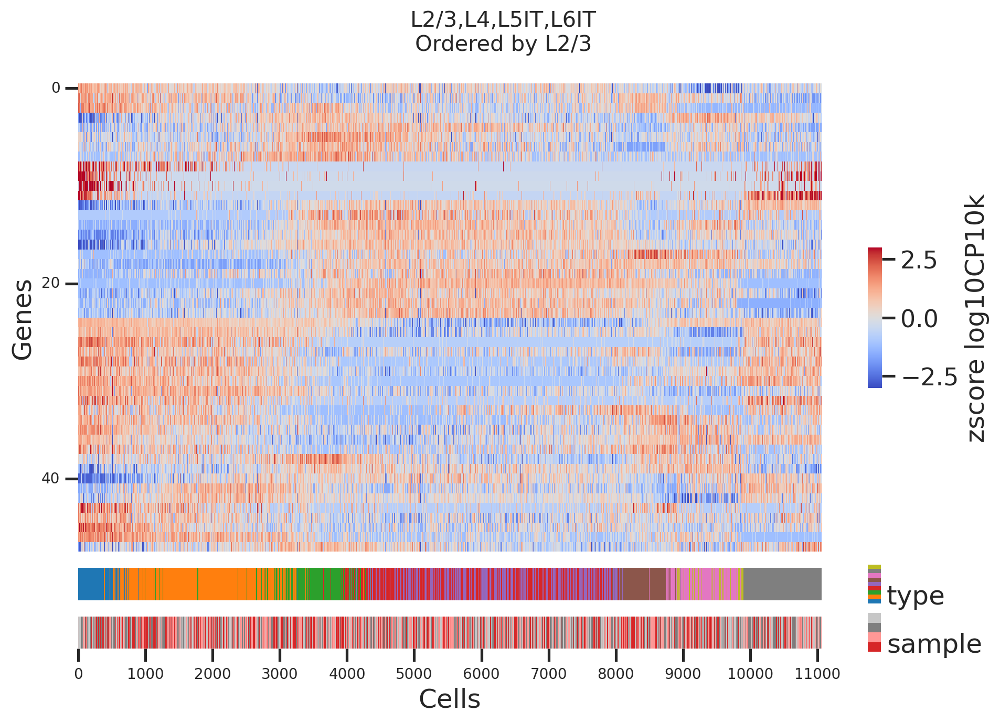

In [68]:
genes_grad_this = genes_sel[cond]
gptime_idx_this = np.argsort(lbls_gg)
run_heatmap_v2(adata_gg, genes_grad_this, cells_this, gptime_idx_this)

# save results
- all these genes - one at a time and annotate them for future studies.
- for updated ptime in P28; for other times and conditions.

In [70]:
criteria_list = {
    'L234': mi_l234 > 0.2,
    'L45':  mi_l45  > 0.2,
    'L56':  mi_l56  > 0.2,
    'L23':  mi_l23  > 0.2,
    'L4':   mi_l4   > 0.2,
    'L5':   mi_l5   > 0.2,
    'L6':   mi_l6   > 0.2,
}

resgenes = []
for lbl, cond in criteria_list.items():
    _res = pd.DataFrame()
    _res['gene'] = genes_sel[cond]
    _res['anno'] = lbl
    resgenes.append(_res)
resgenes = pd.concat(resgenes)
resgenes

,gene,anno
0,Kcnq5,L234
1,Rims1,L234
2,Col19a1,L234
3,Pam,L234
4,Cntnap5a,L234
...,...,...
130,Prr16,L6
131,Chsy3,L6
132,Dcc,L6
133,Rorb,L6


In [71]:
resgenes.groupby('gene').sum()

,anno
gene,
4930578G10Rik,L5
5730522E02Rik,L23
6530403H02Rik,L23
9530059O14Rik,L234L5
A230006K03Rik,L5
...,...
Zeb1,L56L5
Zeb2,L56L5
Zfp804a,L56L6


In [76]:
# fout = os.path.join(outdir, 'P28NR_ITgrad_genes_n749_n338unq_230420.csv')
# resgenes.to_csv(fout, header=True, index=False)
# !head $fout